In [4]:
%pip install nltk spacy pymorphy2 pymorphy2-dicts pymystem3 pandas matplotlib wordcloud

  Using cached pymystem3-0.2.0-py3-none-any.whl (10 kB)
   ---------------------------------------- 0.0/151.4 kB ? eta -:--:--
   -------- ------------------------------- 30.7/151.4 kB ? eta -:--:--
   ----------------------------- ---------- 112.6/151.4 kB 1.3 MB/s eta 0:00:01
   ---------------------------------------- 151.4/151.4 kB 1.3 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [5]:
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.stem import SnowballStemmer
from nltk.tokenize import WordPunctTokenizer
from nltk.tokenize import RegexpTokenizer
from pymystem3 import Mystem
import pandas as pd
import matplotlib
import wordcloud
import spacy
from spacy import displacy

[nltk_data] Downloading package punkt to C:\Users\Дима
[nltk_data]     Титаренко\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Дима Титаренко\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to C:\Users\Дима
[nltk_data]     Титаренко\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
wordpunct = nltk.tokenize.WordPunctTokenizer()
print(wordpunct.tokenize(text))

['1', 'Глава', 'Завещаю', 'в', 'той', 'жизни', 'Вам', 'счастливыми', 'быть', 'И', 'родимой', 'Отчизне', 'С', 'честью', 'дальше', 'служить', '.', 'Горевать', '—', 'горделиво', ',', 'Не', 'клонясь', 'головой', '.', 'Ликовать', '—', 'не', 'хвастливо', 'В', 'час', 'победы', 'самой', '.', 'И', 'беречь', 'ее', 'свято', ',', 'Братья', ',', 'счастье', 'свое', '—', 'В', 'память', 'воина', '-', 'брата', ',', 'Что', 'погиб', 'за', 'нее', '.', 'А', '.', 'Твардовский', 'В', 'двенадцатом', 'часу', 'ночи', 'капитан', 'Новиков', 'проверял', 'посты', '.', 'Он', 'шел', 'по', 'высоте', 'в', 'черной', 'осенней', 'тьме', ',', 'над', 'головой', 'густо', 'шумели', 'вершины', 'сосен', '.', 'Острым', 'северным', 'холодом', 'дуло', 'с', 'Карпат', ',', 'вся', 'высота', 'гудела', ',', 'точно', 'гулко', 'вибрировала', 'под', 'непрерывными', 'ударами', 'воздушных', 'потоков', '.', 'Пахло', 'снегом', '.', 'Редкие', 'ракеты', 'извивались', 'над', 'немецкой', 'передовой', ',', 'сносимые', 'ветром', ',', 'догорали', 'з

In [4]:
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized

['1',
 'Глава',
 'Завещаю',
 'в',
 'той',
 'жизни',
 'Вам',
 'счастливыми',
 'быть',
 'И',
 'родимой',
 'Отчизне',
 'С',
 'честью',
 'дальше',
 'служить',
 '.',
 'Горевать',
 '—',
 'горделиво',
 ',',
 'Не',
 'клонясь',
 'головой',
 '.',
 'Ликовать',
 '—',
 'не',
 'хвастливо',
 'В',
 'час',
 'победы',
 'самой',
 '.',
 'И',
 'беречь',
 'ее',
 'свято',
 ',',
 'Братья',
 ',',
 'счастье',
 'свое',
 '—',
 'В',
 'память',
 'воина-брата',
 ',',
 'Что',
 'погиб',
 'за',
 'нее',
 '.',
 'А.',
 'Твардовский',
 'В',
 'двенадцатом',
 'часу',
 'ночи',
 'капитан',
 'Новиков',
 'проверял',
 'посты',
 '.',
 'Он',
 'шел',
 'по',
 'высоте',
 'в',
 'черной',
 'осенней',
 'тьме',
 ',',
 'над',
 'головой',
 'густо',
 'шумели',
 'вершины',
 'сосен',
 '.',
 'Острым',
 'северным',
 'холодом',
 'дуло',
 'с',
 'Карпат',
 ',',
 'вся',
 'высота',
 'гудела',
 ',',
 'точно',
 'гулко',
 'вибрировала',
 'под',
 'непрерывными',
 'ударами',
 'воздушных',
 'потоков',
 '.',
 'Пахло',
 'снегом',
 '.',
 'Редкие',
 'ракеты',


In [5]:
tagged = nltk.pos_tag(tokenized)
tagged

[('1', 'CD'),
 ('Глава', 'JJ'),
 ('Завещаю', 'NNP'),
 ('в', 'NNP'),
 ('той', 'NNP'),
 ('жизни', 'NNP'),
 ('Вам', 'NNP'),
 ('счастливыми', 'NNP'),
 ('быть', 'NNP'),
 ('И', 'NNP'),
 ('родимой', 'NNP'),
 ('Отчизне', 'NNP'),
 ('С', 'NNP'),
 ('честью', 'NNP'),
 ('дальше', 'NNP'),
 ('служить', 'NNP'),
 ('.', '.'),
 ('Горевать', 'VB'),
 ('—', 'JJ'),
 ('горделиво', 'NNP'),
 (',', ','),
 ('Не', 'NNP'),
 ('клонясь', 'NNP'),
 ('головой', 'NNP'),
 ('.', '.'),
 ('Ликовать', 'VB'),
 ('—', 'JJ'),
 ('не', 'NNP'),
 ('хвастливо', 'NNP'),
 ('В', 'NNP'),
 ('час', 'NNP'),
 ('победы', 'NNP'),
 ('самой', 'NNP'),
 ('.', '.'),
 ('И', 'VB'),
 ('беречь', 'JJ'),
 ('ее', 'NNP'),
 ('свято', 'NNP'),
 (',', ','),
 ('Братья', 'NNP'),
 (',', ','),
 ('счастье', 'NNP'),
 ('свое', 'NNP'),
 ('—', 'NNP'),
 ('В', 'NNP'),
 ('память', 'NNP'),
 ('воина-брата', 'NNP'),
 (',', ','),
 ('Что', 'NNP'),
 ('погиб', 'NNP'),
 ('за', 'NNP'),
 ('нее', 'NNP'),
 ('.', '.'),
 ('А.', 'VB'),
 ('Твардовский', 'JJ'),
 ('В', 'NNP'),
 ('двенадцато

In [6]:
from nltk.stem import WordNetLemmatizer
lemm = WordNetLemmatizer()
lemmatized = [lemm.lemmatize(word) for word in tokenized]
lemmatized

['1',
 'Глава',
 'Завещаю',
 'в',
 'той',
 'жизни',
 'Вам',
 'счастливыми',
 'быть',
 'И',
 'родимой',
 'Отчизне',
 'С',
 'честью',
 'дальше',
 'служить',
 '.',
 'Горевать',
 '—',
 'горделиво',
 ',',
 'Не',
 'клонясь',
 'головой',
 '.',
 'Ликовать',
 '—',
 'не',
 'хвастливо',
 'В',
 'час',
 'победы',
 'самой',
 '.',
 'И',
 'беречь',
 'ее',
 'свято',
 ',',
 'Братья',
 ',',
 'счастье',
 'свое',
 '—',
 'В',
 'память',
 'воина-брата',
 ',',
 'Что',
 'погиб',
 'за',
 'нее',
 '.',
 'А.',
 'Твардовский',
 'В',
 'двенадцатом',
 'часу',
 'ночи',
 'капитан',
 'Новиков',
 'проверял',
 'посты',
 '.',
 'Он',
 'шел',
 'по',
 'высоте',
 'в',
 'черной',
 'осенней',
 'тьме',
 ',',
 'над',
 'головой',
 'густо',
 'шумели',
 'вершины',
 'сосен',
 '.',
 'Острым',
 'северным',
 'холодом',
 'дуло',
 'с',
 'Карпат',
 ',',
 'вся',
 'высота',
 'гудела',
 ',',
 'точно',
 'гулко',
 'вибрировала',
 'под',
 'непрерывными',
 'ударами',
 'воздушных',
 'потоков',
 '.',
 'Пахло',
 'снегом',
 '.',
 'Редкие',
 'ракеты',


In [7]:
def pos_tagger(nltk_tag):
    if nltk_tag.startswith('J'):
        return nltk.corpus.wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return nltk.corpus.wordnet.VERB
    elif nltk_tag.startswith('N'):
        return nltk.corpus.wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return nltk.corpus.wordnet.ADV
    elif nltk_tag.startswith('C'):
        return nltk.corpus.wordnet.CD
    else:          
        return None

tagged

[('1', 'CD'),
 ('Глава', 'JJ'),
 ('Завещаю', 'NNP'),
 ('в', 'NNP'),
 ('той', 'NNP'),
 ('жизни', 'NNP'),
 ('Вам', 'NNP'),
 ('счастливыми', 'NNP'),
 ('быть', 'NNP'),
 ('И', 'NNP'),
 ('родимой', 'NNP'),
 ('Отчизне', 'NNP'),
 ('С', 'NNP'),
 ('честью', 'NNP'),
 ('дальше', 'NNP'),
 ('служить', 'NNP'),
 ('.', '.'),
 ('Горевать', 'VB'),
 ('—', 'JJ'),
 ('горделиво', 'NNP'),
 (',', ','),
 ('Не', 'NNP'),
 ('клонясь', 'NNP'),
 ('головой', 'NNP'),
 ('.', '.'),
 ('Ликовать', 'VB'),
 ('—', 'JJ'),
 ('не', 'NNP'),
 ('хвастливо', 'NNP'),
 ('В', 'NNP'),
 ('час', 'NNP'),
 ('победы', 'NNP'),
 ('самой', 'NNP'),
 ('.', '.'),
 ('И', 'VB'),
 ('беречь', 'JJ'),
 ('ее', 'NNP'),
 ('свято', 'NNP'),
 (',', ','),
 ('Братья', 'NNP'),
 (',', ','),
 ('счастье', 'NNP'),
 ('свое', 'NNP'),
 ('—', 'NNP'),
 ('В', 'NNP'),
 ('память', 'NNP'),
 ('воина-брата', 'NNP'),
 (',', ','),
 ('Что', 'NNP'),
 ('погиб', 'NNP'),
 ('за', 'NNP'),
 ('нее', 'NNP'),
 ('.', '.'),
 ('А.', 'VB'),
 ('Твардовский', 'JJ'),
 ('В', 'NNP'),
 ('двенадцато

In [8]:
# lemmatized = []
# for word, tag in tagged:
#     if tag == None:
#         lemmatized.append(lemm.lemmatize(word))
#     else:
#         lemmatized.append(lemm.lemmatize(word, tag))
# lemmatized

In [9]:
stemmer = SnowballStemmer(language='russian')
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
stemmed = [stemmer.stem(word) for word in tokenized]
stemmed

['1',
 'глав',
 'завеща',
 'в',
 'то',
 'жизн',
 'вам',
 'счастлив',
 'быт',
 'и',
 'родим',
 'отчизн',
 'с',
 'чест',
 'дальш',
 'служ',
 '.',
 'горева',
 '—',
 'горделив',
 ',',
 'не',
 'клон',
 'голов',
 '.',
 'ликова',
 '—',
 'не',
 'хвастлив',
 'в',
 'час',
 'побед',
 'сам',
 '.',
 'и',
 'береч',
 'е',
 'свят',
 ',',
 'брат',
 ',',
 'счаст',
 'сво',
 '—',
 'в',
 'памя',
 'воина-брат',
 ',',
 'что',
 'погиб',
 'за',
 'не',
 '.',
 'а.',
 'твардовск',
 'в',
 'двенадцат',
 'час',
 'ноч',
 'капита',
 'новик',
 'проверя',
 'пост',
 '.',
 'он',
 'шел',
 'по',
 'высот',
 'в',
 'черн',
 'осен',
 'тьме',
 ',',
 'над',
 'голов',
 'густ',
 'шумел',
 'вершин',
 'сос',
 '.',
 'остр',
 'северн',
 'холод',
 'дул',
 'с',
 'карпат',
 ',',
 'вся',
 'высот',
 'гудел',
 ',',
 'точн',
 'гулк',
 'вибрирова',
 'под',
 'непрерывн',
 'удар',
 'воздушн',
 'поток',
 '.',
 'пахл',
 'снег',
 '.',
 'редк',
 'ракет',
 'извива',
 'над',
 'немецк',
 'передов',
 ',',
 'сносим',
 'ветр',
 ',',
 'догора',
 'за',
 'те

In [10]:
SnowballStemmer(language="russian")

In [11]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
    
type(text)
#morph.parse(text, language='russian')

str

In [12]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized
morph.parse(text)

[Parse(word='1 глава\nзавещаю в той жизни\n\nвам счастливыми быть\n\nи родимой отчизне\n\nс честью дальше служить.\n\nгоревать — горделиво,\n\nне клонясь головой.\n\nликовать — не хвастливо\n\nв час победы самой.\n\nи беречь ее свято,\n\nбратья, счастье свое —\n\nв память воина-брата,\n\nчто погиб за нее.\n\nа. твардовский\nв двенадцатом часу ночи капитан новиков проверял посты. он шел по высоте в черной осенней тьме, над головой густо шумели вершины сосен. острым северным холодом дуло с карпат, вся высота гудела, точно гулко вибрировала под непрерывными ударами воздушных потоков. пахло снегом. редкие ракеты извивались над немецкой передовой, сносимые ветром, догорали за темным полукружьем соседней высоты. в низине справа, где лежал польский город касно, беззвучно вспыхивали, гасли неопределенные светы, как будто задувало их. молчали пулеметы. новиков не видел в темноте ни орудия, ни часовых, шел — руки в карманах, ветер неистово трепал полы шинели, — и странное чувство тоски, глухой з

In [13]:
morph = pymorphy2.MorphAnalyzer()
text='завещаю'
morph.parse(text)

[Parse(word='завещаю', tag=OpencorporaTag('VERB,perf,tran sing,1per,futr,indc'), normal_form='завещать', score=0.5, methods_stack=((DictionaryAnalyzer(), 'завещаю', 703, 5),)),
 Parse(word='завещаю', tag=OpencorporaTag('VERB,impf,tran sing,1per,pres,indc'), normal_form='завещать', score=0.5, methods_stack=((DictionaryAnalyzer(), 'завещаю', 703, 15),))]

In [14]:
text_1='служить'
morph.parse(text_1)

[Parse(word='служить', tag=OpencorporaTag('INFN,impf,tran'), normal_form='служить', score=1.0, methods_stack=((DictionaryAnalyzer(), 'служить', 2899, 0),))]

In [15]:
morph.parse('снарядов')

[Parse(word='снарядов', tag=OpencorporaTag('NOUN,inan,masc plur,gent'), normal_form='снаряд', score=1.0, methods_stack=((DictionaryAnalyzer(), 'снарядов', 34, 7),))]

In [16]:
morph.parse('бруствере')

[Parse(word='бруствере', tag=OpencorporaTag('NOUN,inan,masc sing,loct'), normal_form='бруствер', score=1.0, methods_stack=((DictionaryAnalyzer(), 'бруствере', 300, 5),))]

In [17]:
morph.parse('орудия')

[Parse(word='орудия', tag=OpencorporaTag('NOUN,inan,neut sing,gent'), normal_form='орудие', score=0.729729, methods_stack=((DictionaryAnalyzer(), 'орудия', 77, 2),)),
 Parse(word='орудия', tag=OpencorporaTag('NOUN,inan,neut plur,nomn'), normal_form='орудие', score=0.243243, methods_stack=((DictionaryAnalyzer(), 'орудия', 77, 13),)),
 Parse(word='орудия', tag=OpencorporaTag('NOUN,inan,neut plur,accs'), normal_form='орудие', score=0.027027, methods_stack=((DictionaryAnalyzer(), 'орудия', 77, 18),))]

In [18]:
morph.parse('капитан')

[Parse(word='капитан', tag=OpencorporaTag('NOUN,anim,masc sing,nomn'), normal_form='капитан', score=1.0, methods_stack=((DictionaryAnalyzer(), 'капитан', 52, 0),))]

In [19]:
morph.parse('сузив')

[Parse(word='сузив', tag=OpencorporaTag('GRND,perf,tran past'), normal_form='сузить', score=1.0, methods_stack=((DictionaryAnalyzer(), 'сузив', 860, 69),))]

In [20]:
m=Mystem()
m.analyze('1 Глава Завещаю в той жизни Вам счастливыми быть И родимой Отчизне С честью дальше служить. Горевать — горделиво, Не клонясь головой. Ликовать — не хвастливоВ час победы самой. И беречь ее свято, Братья, счастье свое — В память воина-брата, Что погиб за нее.')

[{'text': '1'},
 {'text': ' '},
 {'analysis': [{'lex': 'глава', 'wt': 0.5182047872, 'gr': 'S,муж,од=им,ед'}],
  'text': 'Глава'},
 {'text': ' '},
 {'analysis': [{'lex': 'завещать',
    'wt': 1,
    'gr': 'V,пе=(непрош,ед,изъяв,1-л,несов|непрош,ед,изъяв,1-л,сов)'}],
  'text': 'Завещаю'},
 {'text': ' '},
 {'analysis': [{'lex': 'в', 'wt': 0.9999917878, 'gr': 'PR='}], 'text': 'в'},
 {'text': ' '},
 {'analysis': [{'lex': 'тот',
    'wt': 0.9998024292,
    'gr': 'APRO=(пр,ед,жен|дат,ед,жен|род,ед,жен|твор,ед,жен)'}],
  'text': 'той'},
 {'text': ' '},
 {'analysis': [{'lex': 'жизнь',
    'wt': 1,
    'gr': 'S,жен,неод=(пр,ед|вин,мн|дат,ед|род,ед|им,мн)'}],
  'text': 'жизни'},
 {'text': ' '},
 {'analysis': [{'lex': 'вы', 'wt': 1, 'gr': 'SPRO,мн,2-л=дат'}],
  'text': 'Вам'},
 {'text': ' '},
 {'analysis': [{'lex': 'счастливый', 'wt': 1, 'gr': 'A=твор,мн,полн'}],
  'text': 'счастливыми'},
 {'text': ' '},
 {'analysis': [{'lex': 'быть', 'wt': 1, 'gr': 'V,нп=инф,несов'}],
  'text': 'быть'},
 {'text':

In [21]:
m=Mystem()
m.analyze('В двенадцатом часу ночи капитан Новиков проверял посты. Он шел по высоте в черной осенней тьме, над головой густо шумели вершины сосен. Острым северным холодом дуло с Карпат, вся высота гудела, точно гулко вибрировала под непрерывными ударами воздушных потоков. Пахло снегом. Редкие ракеты извивались над немецкой передовой, сносимые ветром, догорали за темным полукружьем соседней высоты. В низине справа, где лежал польский город Касно, беззвучно вспыхивали, гасли неопределенные светы, как будто задувало их. Молчали пулеметы. Новиков не видел в темноте ни орудия, ни часовых, шел — руки в карманах, ветер неистово трепал полы шинели, — и странное чувство тоски, глухой затерянности в этих мрачных, холодных Карпатах охватывало его. Приступы тоски появлялись в последнюю неделю не раз — и всегда ночью, в короткие затишья, и объяснялись главным образом тем, что четыре дня назад, при взятии города Касно, батарея Новикова впервые потеряла девять человек сразу, в том числе командира взвода управления, и Новиков не мог простить себе этого. — Часовой! — строго окликнул Новиков, останавливаясь, по звуку голосов угадывая впереди землянку первого взвода, вырытую в скате высоты. Ответа не было. — Часовой! — повторил он громче. — А? Что-то черное завозилось, шурша плащ-палаткой, возле входа в землянку, голос из темноты отозвался сдавленно: — А! Кто тут? — Что это за «а»? Черт бы драл! — выругался Новиков. — В прятки играете? — Стой! Кто идет? — преувеличенно грозно выкрикнул часовой и щелкнул затвором автомата.')

[{'analysis': [{'lex': 'в', 'wt': 0.9999917878, 'gr': 'PR='}], 'text': 'В'},
 {'text': ' '},
 {'analysis': [{'lex': 'двенадцатый',
    'wt': 1,
    'gr': 'ANUM=(пр,ед,муж|пр,ед,сред)'}],
  'text': 'двенадцатом'},
 {'text': ' '},
 {'analysis': [{'lex': 'час',
    'wt': 1,
    'gr': 'S,муж,неод=(дат,ед|парт,ед|местн,ед)'}],
  'text': 'часу'},
 {'text': ' '},
 {'analysis': [{'lex': 'ночь',
    'wt': 1,
    'gr': 'S,жен,неод=(пр,ед|вин,мн|дат,ед|род,ед|им,мн|местн,ед)'}],
  'text': 'ночи'},
 {'text': ' '},
 {'analysis': [{'lex': 'капитан', 'wt': 1, 'gr': 'S,муж,од=им,ед'}],
  'text': 'капитан'},
 {'text': ' '},
 {'analysis': [{'lex': 'новиков',
    'wt': 0.9926376892,
    'gr': 'S,фам,муж,од=им,ед'}],
  'text': 'Новиков'},
 {'text': ' '},
 {'analysis': [{'lex': 'проверять',
    'wt': 1,
    'gr': 'V,пе=прош,ед,изъяв,муж,несов'}],
  'text': 'проверял'},
 {'text': ' '},
 {'analysis': [{'lex': 'пост', 'wt': 1, 'gr': 'S,муж,неод=(вин,мн|им,мн)'}],
  'text': 'посты'},
 {'text': '. '},
 {'analys

In [22]:
import string

class Tokenizer:
    @staticmethod
    def tokenizer(text):
# Удаление знаков препинания из текста
        translator = str.maketrans('', '', string.punctuation)
        text = text.translate(translator)

# Разделение текста на токены по пробелам
        tokens = text.split()

        return tokens

In [26]:
import spacy

def remove_stopwords(text):
    nlp = spacy.load('ru_core_news_sm')
    doc = nlp(text)
    words = [token.text for token in doc if not token.is_stop and token.pos_ not in {'ADP', 'PRON', 'PART'}]
    filtered_text = ' '.join(words)

    return filtered_text


with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
filtered_text = remove_stopwords(text)
print(filtered_text)

1 Глава 
 Завещаю жизни 

 счастливыми 

 родимой Отчизне 

 честью служить . 

 Горевать — горделиво , 

 клонясь головой . 

 Ликовать — хвастливо 

 час победы . 

 беречь свято , 

 Братья , счастье — 

 память воина - брата , 

 погиб . 

 А. Твардовский 
 двенадцатом часу ночи капитан Новиков проверял посты . шел высоте черной осенней тьме , головой густо шумели вершины сосен . Острым северным холодом дуло Карпат , высота гудела , гулко вибрировала непрерывными ударами воздушных потоков . Пахло снегом . Редкие ракеты извивались немецкой передовой , сносимые ветром , догорали темным полукружьем соседней высоты . низине справа , лежал польский город Касно , беззвучно вспыхивали , гасли неопределенные светы , задувало . Молчали пулеметы . Новиков видел темноте ни орудия , ни часовых , шел — руки карманах , ветер неистово трепал полы шинели , — странное чувство тоски , глухой затерянности мрачных , холодных Карпатах охватывало . Приступы тоски появлялись последнюю неделю раз — ночью 

In [ ]:
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
tokenizer = Tokenizer()
tokens = tokenizer.tokenizer(text)
print(tokens)
m=Mystem()
m.analyze('В двенадцатом часу ночи капитан Новиков проверял посты. Он шел по высоте в черной осенней тьме, над головой густо шумели вершины сосен. Острым северным холодом дуло с Карпат, вся высота гудела, точно гулко вибрировала под непрерывными ударами воздушных потоков. Пахло снегом. Редкие ракеты извивались над немецкой передовой, сносимые ветром, догорали за темным полукружьем соседней высоты. В низине справа, где лежал польский город Касно, беззвучно вспыхивали, гасли неопределенные светы, как будто задувало их. Молчали пулеметы. Новиков не видел в темноте ни орудия, ни часовых, шел — руки в карманах, ветер неистово трепал полы шинели, — и странное чувство тоски, глухой затерянности в этих мрачных, холодных Карпатах охватывало его. Приступы тоски появлялись в последнюю неделю не раз — и всегда ночью, в короткие затишья, и объяснялись главным образом тем, что четыре дня назад, при взятии города Касно, батарея Новикова впервые потеряла девять человек сразу, в том числе командира взвода управления, и Новиков не мог простить себе этого. — Часовой! — строго окликнул Новиков, останавливаясь, по звуку голосов угадывая впереди землянку первого взвода, вырытую в скате высоты. Ответа не было. — Часовой! — повторил он громче. — А? Что-то черное завозилось, шурша плащ-палаткой, возле входа в землянку, голос из темноты отозвался сдавленно: — А! Кто тут? — Что это за «а»? Черт бы драл! — выругался Новиков. — В прятки играете? — Стой! Кто идет? — преувеличенно грозно выкрикнул часовой и щелкнул затвором автомата. — Проснулись? Что там за колготня в землянке? — спросил Новиков недовольным тоном. — Что молчите? — Овчинников чегой-то шумит, товарищ капитан, — робко кашлянув, забормотал часовой. — И чего они разоряются? Новиков толкнул дверь в землянку. Плотный гул голосов колыхался под низкими накатами. Среди дыма плавали фиолетовые огни немецких плошек, мутно проступали за столом и на нарах красно-багровые лица солдат — все говорили разом, нещадно курили. Командир первого взвода лейтенант Овчинников, с тонким, красивым, самолюбивым ртом, ударил кулаком по столу, покачиваясь, встал, затем, небрежно оттолкнув на бедре тяжелую кобуру пистолета, скомандовал: сипло и властно: — Прекратить галдеж и слушай тост! За Леночку! А, братцы? Пить всем! Смутный рев голосов ответил ему и стих: все увидели молча стоявшего в дверях капитана Новикова. Он медленно обвел взглядом лица солдат. — Значит, пыль столбом? — произнес он, хмурясь. — И санинструктор здесь? То, что веселье это происходило в восьмистах метрах от немецкой передовой и люди, зная это, не сдерживали себя, не удивило Новикова. Удивило то, что здесь, среди едкого махорочного дыма, среди этого нетрезвого шума, сидела на нарах санинструктор Лена Колоскова. Сидела она, охватив руками колени и покачиваясь взад и вперед, разговаривала с умиленно расплывшимся замковым Лягаловым, смеялась тихим, трудным, ласковым смехом. «Смеется каким-то жемчужным смехом, — не без раздражения подумал Новиков. — Она пьяна или хочет понравиться лейтенанту Овчинникову. Зачем ей это?» И, стараясь еще более возбудить в себе неприязнь к этому легкомысленному смеху, он быстро взглянул на нее, потом на Овчинникова, спросил: — Что у вас тут? Свадьба?. Он произнес это, должно быть, грубо — все замолчали. Лена вопросительно перевела на него взгляд и вдруг легко и гибко спрыгнула с нар, взяла со стола чей-то стакан, подошла к Новикову, блестя яркими, чуть прищуренными, улыбающимися глазами. — Да, именно, — сказала, откидывая голову, — здесь свадьба. Поздравьте меня и Овчинникова. Лейтенант Овчинников! — приказала она. — Дайте водки капитану! «Что это с ней?» Она не была пьяна, кажется (а вообще не поймешь!), и дерзко глядела на него снизу вверх, — тонкая нежная шея окаймлена воротом, узкие плечи, крепкая маленькая грудь обтянута суконной гимнастеркой, сжатой в талии широким ремнем. Не раз ловил себя Новиков на том, что его непривычно смущала постоянная вызывающая смелость санинструктора, — он почувствовал, что покраснел на виду мгновенно притихших солдат, и, разозленный на себя за это, резко сказал: — Вы всегда неудачно шутите, товарищ санинструктор! — И, повернувшись к лейтенанту Овчинникову, договорил тоном приказа: — Прекратить! Что это за веселье? С какой радости? Всем отдыхать! Лейтенант Овчинников, самолюбиво сузив светло трезвые глаза на недопитый стакан, спросил: — За что вы, товарищ капитан? Мой день рождения. Не признаете? Двадцать шесть стукнуло. Лягалов, налей комбату! Ломанем, товарищ капитан?.. Чтоб пыль на всю Европу, а? Замковый Лягалов, солдат пожилой, некрасивый, низкорослый, обросший золотистой щетинкой на худых щеках, помигал конфузливо на Овчинникова, на комбата, неуверенно налил из фляги полную кружку, протянул Новикову: — Товарищ капитан, не побрезгуйте, стадо быть… Чистая-а! Считался Лягалов непьющим, и то, что он пил сейчас и протягивал кружку, вконец испортило настроение Новикову. Он оттолкнул руку Лягалова, криво усмехнулся: — Поздравляю. — И, ссутулившись, шагнул к двери. Уже на пороге услышал позади себя неловкую тишину, и стало ему неприятно оттого, что он только что внес в землянку, к солдатам Овчинникова, которых любил, холод и раздражение. Он знал, что Лена была развращена постоянным мужским вниманием, — это, разумеется, было связано с ее прошлой службой в полковой разведке. Она пришла в батарею месяца два назад после непонятной истории в полку, о которой всезнающие штабные писаря вынуждены были молчать. Ходили слухи: она набила морду и едва не застрелила адъютанта командира полка. Однако Новиков мало верил этому. Походили на правду иные слухи: говорили о ее особенной близости с разведчиками. И Новиков, видя ее маленькую точеную фигуру, ее порочно аккуратную грудь, обрисованную гимнастеркой, лучисто-теплый свет ее глаз, когда она улыбалась, часто слыша ее смех, который тоже был как бы тайно порочен, испытывал болезненные приступы раздражительности. Оттого, что она, казалось, была доступна всем, она была недоступной для него. В первые дни пребывания нового санинструктора в батарее был он с ней нестеснителен, полунасмешлив, иногда в присутствии ее не сдерживался в сильных выражениях — не божий одуванчик, не то видела! После, лежа один в своей землянке, он, мучаясь, вспоминал то чувство, какое испытывал, когда ругался, словно не замечая ее, и не находил успокоения. Его стесняла, ему мешала эта женщина в батарее. Но одновременно, даже не видя ее, он все время ощущал ее присутствие и не мог объяснить себе то внезапное неприязненное раздражение, которое она своей смелостью, своим голосом вызывала в нем. Выйдя из землянки, Новиков один постоял в холодной осенней тьме. Мысль о том, что он грубо обидел сейчас солдат, обидел тогда, когда от расчетов его батареи осталось двадцать человек, когда он должен быть добрей, ласковее с людьми, угнетала его. Ветер гудел в ушах, и в тяжком скрипе сосен слышался Новикову пьяный гул голосов; и оттого, что в землянке бездумно пили спирт и смеялись, как бы забыв о тех, кого похоронили вчера, Новиков испытывал знакомое чувство тоски. Ощупью нашел пенек — видел его еще днем, — сел, до боли потер небритые щеки, посмотрел в потемки, туда, где за высотой, в полутора километрах отсюда, на западной окраине Касно, стояли два орудия младшего лейтенанта Алешина — второй в батарее взвод, который он, Новиков, особенно берег. Там не взлетали ракеты. — Я пошла! — раздался женский голос в нескольких шагах от Новикова. Из землянки вырвался, стих шум голосов. Желтая полоса света легла на кусты, легкие шаги послышались в четырех метрах от Новикова, и по голосу, по смутному очертанию фигуры он узнал Лену. Она остановилась возле, не видя Новикова, долго глядела на прижатые к горам близкие вспышки ракет — среди шумящих деревьев появлялось ее бледное лицо с непонятно решительным выражением. Сквозь гудение сосен глухо хлопнула дверь, из землянки выбежал лейтенант Овчинников в распахнутой телогрейке, окликнул сипловатым голосом: — Ты куда ж, Леночка?.. Постой! — Я стою. Ну а вы зачем? — спросила она негромко. — Я и сама дойду! Он подошел к ней, проговорил требовательно: — Куда? — К разведчикам. Они здесь недалеко, — ответила она насмешливо. — Не привыкла я к вашей батарее. Непохожи вы на разведчиков, лейтенант Овчинников придвинулся к ней, сказал тяжелым голосом: — Непохожи? Хочешь, я ради тебя вон там под пули встану? Хочешь? Не знаешь ты еще!.. — Ну, этого не надо! — Она засмеялась. — Глупость это! Тогда он сказал с отчаянием: — Так, да? Все равно не отпущу! Ты наших не знаешь! Он приблизился к ней вплотную, они будто слились, и тотчас Лена сказала презрительно, протяжно, устало, переходя на «ты»: — Уйди-и, не справишься ты со мной… Губы у тебя мокрые, лейтенант… Она оттолкнула его, пошла прочь, а он, сделав шаг назад, позвал громко: «Леночка, постой!» — и кинулся следом за ней. В его сбившемся дыхании, в коротком неуверенном крике было что-то неприятно молящее, унижающее мужское достоинство, и Новиков поморщился. Он встал, пошел к своему блиндажу. Блиндаж был полуосвещен сонным, желтым мерцанием коптилки. Воздух был тепел, плотен, пахло шинелями, лежалой соломой. Дежурный телефонист Гусев, молодой, круглоголовый, прислонясь затылком к стене, спал — устало подергивались брови, потухшая цигарка прилипла к оттопыренной губе, другая — свернутая — заложена за ухо. Перед ним на снарядном ящике котелок: из недоеденной пшенной каши торчала деревянная ложка. Возле котелка огрызок обмусоленного чернильного карандаша, измятый листок, вырванный из тетради, ровные, аккуратные строчки были усыпаны хлебными крошками. Видимо, ел и писал письмо. Новиков взглянул на листок, невольно усмехнулся этому аккуратному школьному почерку: «Ты меня не ревнуй, потому что у нас тут женщин нет, только одна сестра, да и то больно некрасивая…» Он хотел спросить связиста, звонил ли командир дивизиона, но будить было жалко. Вокруг с тревожным всхлипыванием, бредовым бормотанием спали солдаты. Новиков, не раздеваясь, лег на спину, сбоку нар, на обычное свое место. Закрыл глаза и будто погрузился в горячий, парной воздух, полный разлетающихся искр, в хаос несвязных людских голосов, и мутно среди них колыхались лица Лены, лейтенанта Овчинникова — обычный, непонятный мгновенный сон. Он проснулся от сильного гула, давящего на голову, вскочил, пьяный от сна.')

['1', 'Глава', 'Завещаю', 'в', 'той', 'жизни', 'Вам', 'счастливыми', 'быть', 'И', 'родимой', 'Отчизне', 'С', 'честью', 'дальше', 'служить', 'Горевать', '—', 'горделиво', 'Не', 'клонясь', 'головой', 'Ликовать', '—', 'не', 'хвастливо', 'В', 'час', 'победы', 'самой', 'И', 'беречь', 'ее', 'свято', 'Братья', 'счастье', 'свое', '—', 'В', 'память', 'воинабрата', 'Что', 'погиб', 'за', 'нее', 'А', 'Твардовский', 'В', 'двенадцатом', 'часу', 'ночи', 'капитан', 'Новиков', 'проверял', 'посты', 'Он', 'шел', 'по', 'высоте', 'в', 'черной', 'осенней', 'тьме', 'над', 'головой', 'густо', 'шумели', 'вершины', 'сосен', 'Острым', 'северным', 'холодом', 'дуло', 'с', 'Карпат', 'вся', 'высота', 'гудела', 'точно', 'гулко', 'вибрировала', 'под', 'непрерывными', 'ударами', 'воздушных', 'потоков', 'Пахло', 'снегом', 'Редкие', 'ракеты', 'извивались', 'над', 'немецкой', 'передовой', 'сносимые', 'ветром', 'догорали', 'за', 'темным', 'полукружьем', 'соседней', 'высоты', 'В', 'низине', 'справа', 'где', 'лежал', 'польск

[{'analysis': [{'lex': 'в', 'wt': 0.9999917878, 'gr': 'PR='}], 'text': 'В'},
 {'text': ' '},
 {'analysis': [{'lex': 'двенадцатый',
    'wt': 1,
    'gr': 'ANUM=(пр,ед,муж|пр,ед,сред)'}],
  'text': 'двенадцатом'},
 {'text': ' '},
 {'analysis': [{'lex': 'час',
    'wt': 1,
    'gr': 'S,муж,неод=(дат,ед|парт,ед|местн,ед)'}],
  'text': 'часу'},
 {'text': ' '},
 {'analysis': [{'lex': 'ночь',
    'wt': 1,
    'gr': 'S,жен,неод=(пр,ед|вин,мн|дат,ед|род,ед|им,мн|местн,ед)'}],
  'text': 'ночи'},
 {'text': ' '},
 {'analysis': [{'lex': 'капитан', 'wt': 1, 'gr': 'S,муж,од=им,ед'}],
  'text': 'капитан'},
 {'text': ' '},
 {'analysis': [{'lex': 'новиков',
    'wt': 0.9926376892,
    'gr': 'S,фам,муж,од=им,ед'}],
  'text': 'Новиков'},
 {'text': ' '},
 {'analysis': [{'lex': 'проверять',
    'wt': 1,
    'gr': 'V,пе=прош,ед,изъяв,муж,несов'}],
  'text': 'проверял'},
 {'text': ' '},
 {'analysis': [{'lex': 'пост', 'wt': 1, 'gr': 'S,муж,неод=(вин,мн|им,мн)'}],
  'text': 'посты'},
 {'text': '. '},
 {'analys

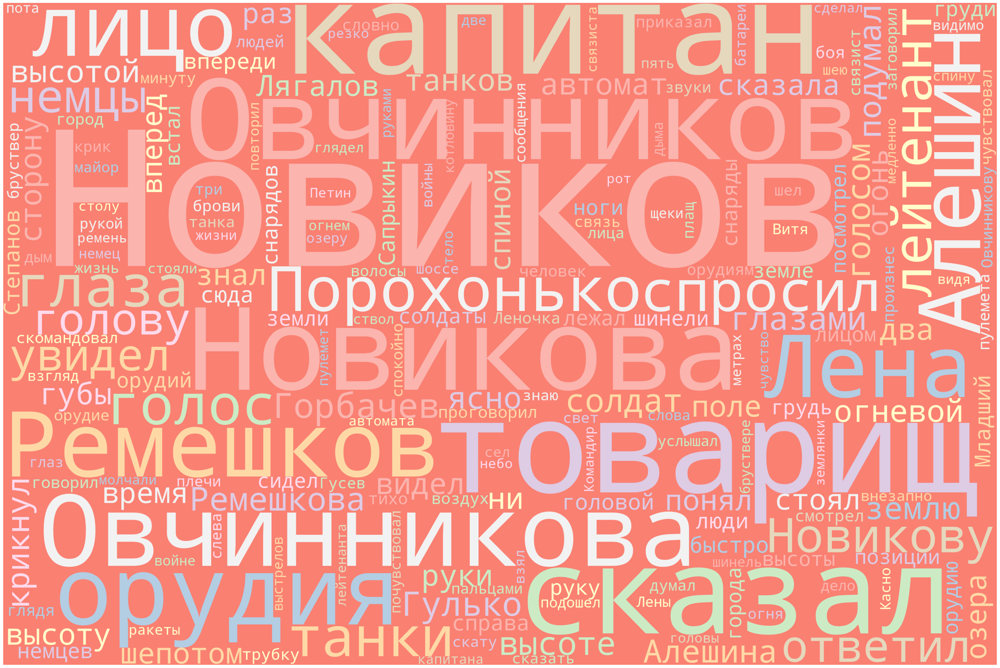

In [27]:
import re 
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS 
with open("Last_volleys.txt", encoding="utf-8") as file:
    text = file.read()
# Clean text 
text = re.sub(r'==.*?==+', '', text) 
text = text.replace('\n', '') 
# Define a function to plot word cloud 
def plot_cloud(wordcloud): 
    # Set figure size 
    plt.figure(figsize=(40, 30)) 
    # Display image 
    plt.imshow(wordcloud)  
    # No axis details 
    plt.axis("off") 
# Generate word cloud 
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(filtered_text) 
plot_cloud(wordcloud)

SOMETHING

In [ ]:
# text=' Витя'
# words = text.split()

In [ ]:
# for word in words:
#     analysis = morph.parse(word)

In [ ]:
# for result in analysis:
#     parsed_word = result.word   
#     normal_form = result.normal_form
#     pos = result.tag.POS
#     case = result.tag.case

In [ ]:
# print(f"Слово: {parsed_word}, нормальная форма: {normal_form}, часть речи: {pos}, падеж: {case}")

Слово: витя, нормальная форма: витя, часть речи: NOUN, падеж: nomn


In [ ]:
with open("Forgive_us!.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized

['Юрий',
 'Бондарев',
 '«',
 'ПРОСТИТЕ',
 'НАС',
 '!',
 '»',
 'Южный',
 'экспресс',
 'задержался',
 'здесь',
 'не',
 'более',
 'пяти',
 'минут',
 '.',
 'Павел',
 'Георгиевич',
 'долго',
 'стоял',
 'на',
 'безлюдной',
 'платформе',
 'и',
 'слушал',
 'горячую',
 'трескотню',
 'кузнечиков',
 'за',
 'насыпью',
 'степного',
 'разъезда',
 '.',
 'После',
 'духоты',
 'вагона',
 ',',
 'утомительных',
 'дорожных',
 'разговоров',
 'в',
 'накуренном',
 'купе',
 'за',
 'полночным',
 'преферансом',
 ',',
 'ненужных',
 'знакомств',
 ',',
 'после',
 'надоедливого',
 'поскрипывания',
 'полок',
 'Павла',
 'Георгиевича',
 'охватила',
 'неправдоподобная',
 'тишина',
 ',',
 'казалось',
 ',',
 'совсем',
 'как',
 'в',
 'детстве',
 '.',
 'Он',
 'не',
 'без',
 'удовольствия',
 'сел',
 'на',
 'чемодан',
 ',',
 'перекинул',
 'плащ',
 'через',
 'плечо',
 'и',
 'сидел',
 'так',
 ',',
 'оглядываясь',
 'со',
 'счастливым',
 'облегчением',
 '.',
 'Хотя',
 'по',
 'роду',
 'своей',
 'профессии',
 'ему',
 'не',
 'так',


In [ ]:
tagged = nltk.pos_tag(tokenized)
tagged

[('Юрий', 'JJ'),
 ('Бондарев', 'NNP'),
 ('«', 'NNP'),
 ('ПРОСТИТЕ', 'NNP'),
 ('НАС', 'NN'),
 ('!', '.'),
 ('»', 'JJ'),
 ('Южный', 'JJ'),
 ('экспресс', 'NN'),
 ('задержался', 'NNP'),
 ('здесь', 'NNP'),
 ('не', 'NNP'),
 ('более', 'NNP'),
 ('пяти', 'NNP'),
 ('минут', 'NNP'),
 ('.', '.'),
 ('Павел', 'VB'),
 ('Георгиевич', 'JJ'),
 ('долго', 'NNP'),
 ('стоял', 'NNP'),
 ('на', 'NNP'),
 ('безлюдной', 'NNP'),
 ('платформе', 'NNP'),
 ('и', 'NNP'),
 ('слушал', 'NNP'),
 ('горячую', 'NNP'),
 ('трескотню', 'NNP'),
 ('кузнечиков', 'NNP'),
 ('за', 'NNP'),
 ('насыпью', 'NNP'),
 ('степного', 'NNP'),
 ('разъезда', 'NNP'),
 ('.', '.'),
 ('После', 'VB'),
 ('духоты', 'JJ'),
 ('вагона', 'NNP'),
 (',', ','),
 ('утомительных', 'NNP'),
 ('дорожных', 'NNP'),
 ('разговоров', 'NNP'),
 ('в', 'NNP'),
 ('накуренном', 'NNP'),
 ('купе', 'NNP'),
 ('за', 'NNP'),
 ('полночным', 'NNP'),
 ('преферансом', 'NNP'),
 (',', ','),
 ('ненужных', 'NNP'),
 ('знакомств', 'NNP'),
 (',', ','),
 ('после', 'NNP'),
 ('надоедливого', 'NNP'

In [ ]:
from nltk.stem import WordNetLemmatizer
lemm = WordNetLemmatizer()
lemmatized = [lemm.lemmatize(word) for word in tokenized]
lemmatized

['Юрий',
 'Бондарев',
 '«',
 'ПРОСТИТЕ',
 'НАС',
 '!',
 '»',
 'Южный',
 'экспресс',
 'задержался',
 'здесь',
 'не',
 'более',
 'пяти',
 'минут',
 '.',
 'Павел',
 'Георгиевич',
 'долго',
 'стоял',
 'на',
 'безлюдной',
 'платформе',
 'и',
 'слушал',
 'горячую',
 'трескотню',
 'кузнечиков',
 'за',
 'насыпью',
 'степного',
 'разъезда',
 '.',
 'После',
 'духоты',
 'вагона',
 ',',
 'утомительных',
 'дорожных',
 'разговоров',
 'в',
 'накуренном',
 'купе',
 'за',
 'полночным',
 'преферансом',
 ',',
 'ненужных',
 'знакомств',
 ',',
 'после',
 'надоедливого',
 'поскрипывания',
 'полок',
 'Павла',
 'Георгиевича',
 'охватила',
 'неправдоподобная',
 'тишина',
 ',',
 'казалось',
 ',',
 'совсем',
 'как',
 'в',
 'детстве',
 '.',
 'Он',
 'не',
 'без',
 'удовольствия',
 'сел',
 'на',
 'чемодан',
 ',',
 'перекинул',
 'плащ',
 'через',
 'плечо',
 'и',
 'сидел',
 'так',
 ',',
 'оглядываясь',
 'со',
 'счастливым',
 'облегчением',
 '.',
 'Хотя',
 'по',
 'роду',
 'своей',
 'профессии',
 'ему',
 'не',
 'так',


In [ ]:
def pos_tagger(nltk_tag):
    if nltk_tag.startswith('J'):
        return nltk.corpus.wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return nltk.corpus.wordnet.VERB
    elif nltk_tag.startswith('N'):
        return nltk.corpus.wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return nltk.corpus.wordnet.ADV
    else:          
        return None

tagged

[('Юрий', 'JJ'),
 ('Бондарев', 'NNP'),
 ('«', 'NNP'),
 ('ПРОСТИТЕ', 'NNP'),
 ('НАС', 'NN'),
 ('!', '.'),
 ('»', 'JJ'),
 ('Южный', 'JJ'),
 ('экспресс', 'NN'),
 ('задержался', 'NNP'),
 ('здесь', 'NNP'),
 ('не', 'NNP'),
 ('более', 'NNP'),
 ('пяти', 'NNP'),
 ('минут', 'NNP'),
 ('.', '.'),
 ('Павел', 'VB'),
 ('Георгиевич', 'JJ'),
 ('долго', 'NNP'),
 ('стоял', 'NNP'),
 ('на', 'NNP'),
 ('безлюдной', 'NNP'),
 ('платформе', 'NNP'),
 ('и', 'NNP'),
 ('слушал', 'NNP'),
 ('горячую', 'NNP'),
 ('трескотню', 'NNP'),
 ('кузнечиков', 'NNP'),
 ('за', 'NNP'),
 ('насыпью', 'NNP'),
 ('степного', 'NNP'),
 ('разъезда', 'NNP'),
 ('.', '.'),
 ('После', 'VB'),
 ('духоты', 'JJ'),
 ('вагона', 'NNP'),
 (',', ','),
 ('утомительных', 'NNP'),
 ('дорожных', 'NNP'),
 ('разговоров', 'NNP'),
 ('в', 'NNP'),
 ('накуренном', 'NNP'),
 ('купе', 'NNP'),
 ('за', 'NNP'),
 ('полночным', 'NNP'),
 ('преферансом', 'NNP'),
 (',', ','),
 ('ненужных', 'NNP'),
 ('знакомств', 'NNP'),
 (',', ','),
 ('после', 'NNP'),
 ('надоедливого', 'NNP'

In [ ]:
stemmer = SnowballStemmer(language='russian')
with open("Forgive_us!.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
stemmed = [stemmer.stem(word) for word in tokenized]
stemmed

['юр',
 'бондар',
 '«',
 'прост',
 'нас',
 '!',
 '»',
 'южн',
 'экспресс',
 'задержа',
 'зде',
 'не',
 'бол',
 'пят',
 'минут',
 '.',
 'павел',
 'георгиевич',
 'долг',
 'стоя',
 'на',
 'безлюдн',
 'платформ',
 'и',
 'слуша',
 'горяч',
 'трескотн',
 'кузнечик',
 'за',
 'насып',
 'степн',
 'разъезд',
 '.',
 'посл',
 'духот',
 'вагон',
 ',',
 'утомительн',
 'дорожн',
 'разговор',
 'в',
 'накурен',
 'куп',
 'за',
 'полночн',
 'преферанс',
 ',',
 'ненужн',
 'знакомств',
 ',',
 'посл',
 'надоедлив',
 'поскрипыван',
 'полок',
 'павл',
 'георгиевич',
 'охват',
 'неправдоподобн',
 'тишин',
 ',',
 'каза',
 ',',
 'совс',
 'как',
 'в',
 'детств',
 '.',
 'он',
 'не',
 'без',
 'удовольств',
 'сел',
 'на',
 'чемода',
 ',',
 'перекинул',
 'плащ',
 'через',
 'плеч',
 'и',
 'сидел',
 'так',
 ',',
 'оглядыв',
 'со',
 'счастлив',
 'облегчен',
 '.',
 'хот',
 'по',
 'род',
 'сво',
 'професс',
 'ем',
 'не',
 'так',
 'мног',
 'приход',
 'езд',
 ',',
 'он',
 'непонятн',
 'поч',
 'люб',
 'нефтян',
 'зап',
 'шпа

In [ ]:
# import nltk
# sentence = "There is floating a brick from the town of Byron"
# tokenized = nltk.tokenize.NLTKWordTokenizer().tokenize(sentence)
# tagged = nltk.pos_tag(tokenized)
# tagged


In [ ]:
# grammar = "NP:{<DT>?<JJ>*<NN>}"
# reg_parser = nltk.RegexpParser(grammar)
# output = reg_parser.parse(tagged)
# output.draw()

In [ ]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Forgive_us!.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized
morph.parse(text)

[Parse(word='юрий бондарев\n\n«простите нас!»\n\nюжный экспресс задержался здесь не более пяти минут. павел георгиевич долго стоял на безлюдной платформе и слушал горячую трескотню кузнечиков за насыпью степного разъезда.\n\nпосле духоты вагона, утомительных дорожных разговоров в накуренном купе за полночным преферансом, ненужных знакомств, после надоедливого поскрипывания полок павла георгиевича охватила неправдоподобная тишина, казалось, совсем как в детстве.\n\nон не без удовольствия сел на чемодан, перекинул плащ через плечо и сидел так, оглядываясь со счастливым облегчением. хотя по роду своей профессии ему не так много приходилось ездить, он непонятно почему любил нефтяной запах шпал, гудки паровозов, спешащий перестук колес, мотание из стороны в сторону последней площадки, где в руке кондуктора мелькал выцветший свернутый флажок, теплый ветер от бегущих вагонов — все это будило смутное желание к движению, к перемене мест.\n\nиногда в москве, до глубокой ночи засиживаясь над черт

In [24]:
with open("Forgive_us!.txt", encoding="utf-8") as file:
    text = file.read()
tokenizer = Tokenizer()
tokens = tokenizer.tokenizer(text)
print(tokens)
m=Mystem()
m.analyze('«ПРОСТИТЕ НАС!» Южный экспресс задержался здесь не более пяти минут. Павел Георгиевич долго стоял на безлюдной платформе и слушал горячую трескотню кузнечиков за насыпью степного разъезда. После духоты вагона, утомительных дорожных разговоров в накуренном купе за полночным преферансом, ненужных знакомств, после надоедливого поскрипывания полок Павла Георгиевича охватила неправдоподобная тишина, казалось, совсем как в детстве. Он не без удовольствия сел на чемодан, перекинул плащ через плечо и сидел так, оглядываясь со счастливым облегчением. Хотя по роду своей профессии ему не так много приходилось ездить, он непонятно почему любил нефтяной запах шпал, гудки паровозов, спешащий перестук колес, мотание из стороны в сторону последней площадки, где в руке кондуктора мелькал выцветший свернутый флажок, теплый ветер от бегущих вагонов — все это будило смутное желание к движению, к перемене мест. Иногда в Москве, до глубокой ночи засиживаясь над чертежами, он подымал голову, глядя в распахнутое в тополя окно, и, задумавшись, подолгу слушал, как вкрадчиво над спящим городом перекликались на вокзалах ночные поезда. Порой гудки мешали ему, будоражили его, и отчего-то тогда вспоминалась вечереющая степь с пыльным закатом над темными стогами, и, подхваченный волнением, он бросал работу, на цыпочках, чтобы не разбудить жену, уходил из дому, бродил по пустынным и тихим улицам. Павел Георгиевич Сафонов работал на большом заводе конструктором, был известен, с годами привык к этой известности и, казалось, даже немного устал от нее, как порой устают люди, когда к ним рано приходит успех и удовлетворение. В этом году Сафонов, утомленный сложной зимней работой, был в санатории на Южном берегу Крыма. Ослепительно-солнечный юг с его острой, сухой жарой, неестественно экзотическими пальмами на бульварах, прокаленный песок пляжа, купание и процедурное лежание под теплым йодистым дуновением моря, весь санаторный режим располагали к безделью, одолевала курортная лень, и мысли в эту жару тоже были притупленные, ленивые, и хотелось быстрее в Москву, к осенним дождям, к мокрому асфальту, к блеску фонарей в лужах. Южный экспресс, на котором Сафонов возвращался из санатория, мчал его по знакомым местам, где Павел Георгиевич родился, вырос, где он не был много лет. Утром, глядя в овлажненные окна тамбура на прохладную степь, Сафонов с какой-то грустной обостренностью вспоминал то, что уже было полузабыто: вот он, мальчишка, в грязной сатиновой рубашке, с цыпками на руках, бежит по этой ледяной от росы степи, бежит вслед за поездом неизвестно куда, и отяжелевшая от влаги трава хлещет его по коленям, приятно холодит ноги… Сколько тогда ему было лет? Порой ясно чудилось, будто вместе с Верой он идет по лунным косякам на Шахтинском холме, внятно и резко пахнет из низин полынью, и потрескавшиеся, обветренные губы Веры тоже пахнут полынью. Воспоминания возвращали его в давний прожитый (а может быть, непрожитый) мир, говорили, напоминали, что ему уже за сорок и что не так много сделано в его жизни, где давно, отмеченная прочными вехами, первая молодость прошла. И вдруг его непреодолимо потянуло побывать в родном своем степном городке: побродить по нему, почитать афиши на заборах, увидеть старые названия улиц, узнать, что изменилось в нем за многие годы, непременно встретить знакомых школьных лет, таких далеких, словно их и не было. Ему страстно захотелось посидеть с другом юности Витькой Снегиревым где-нибудь в летнем кафе, под тентом, за холодным пивом, вспомнить то наивное, давнее и милое, что уже никогда не повторится, но что все-таки было когда-то в его жизни. И хотя это желание победило, Павел Георгиевич с ироническим видом потер нос (в свои годы он иногда подтрунивал над собственными желаниями), вошел в купе, где все спали, подумал еще раз, уложил чемодан, взял плащ и, к удивлению заспанного проводника, бесшумно подметающего в коридоре, сошел на маленьком разъезде этим ранним августовским утром. Он сошел не на вокзале в городе, а именно здесь, чтобы дойти до города пешком. Южный экспресс с жаркими от зари стеклами, с запыленными занавесками тронулся, полетели вдоль насыпи бумажки, поднятые ветром, и ушел быстро; дымки почти беззвучного паровоза таяли среди сиренево стекленеющего неба далеко на западе, все стихло. Только у самой насыпи неумолчно звенели, трещали в неестественной тишине кузнечики. Сидя на чемодане, Сафонов не без волнения выкурил папиросу, подумал: «Необычайно хорошо!» — и с наслаждением вдохнул на полную грудь зябкий и чистый, как ключевая вода, воздух. Степь, по-летнему пестрая, в этот спокойный час утра тепло и ало краснела за холмами на востоке. Там, в эту пылающую, мнилось, бесконечность пылила вдали по косогору грузовая машина, и, четко вырезанные по красному, проступали терриконики, дальние силуэты водонапорной башни, оазисы беленьких домов, острые верхушки тополей. С насыпи Павел Георгиевич не торопясь спустился в степь, как в чашу, полную еще сырой прохлады; тугой волной обдавало горьковатым запахом полыни. И пока он выбрался на дорогу, колени его стали влажными от росы, на плащ, на брюки нацеплялись репейники, чемодан облепили мокрые лепестки. Он шагал по дороге, приятно утопая ботинками в мягкой пыли, затем сорвал прутик с молодой липкой кожицей; по-мальчишески сбивая росу, ударил им по головке какого-то фиолетового цветка у обочины (название которого в детстве знал, но теперь забыл). Из глубины цветка неожиданно поднялся сонный золотистый шмель, весь в намокшей пыльце, и тяжело, сердито прогудел мимо. — Ишь ты! — сказал Павел Георгиевич, провожая его веселым взглядом. — Прости, если потревожил… Когда Сафонов вошел в родной городок, окраины встретили его длинными, через всю дорогу, тенями от старых тополей; кое-где в садах подымался синеватый самоварный дымок, ветви обогретых солнцем яблонь свешивались через заборы. Сафонов шел, помахивая прутиком, глубоко вдыхал запах садовой свежести, этот смолистый самоварный дымок — эти запахи, эти тени от тополей напоминали детство, голубятню, игры в Чапаева, сокрушительные набеги на чужие сады, — как давно это было! Да было ли? Весь день он ходил по городу и не узнавал его. И город не узнавал Сафонова. Старинный степной этот городок был точно заново заселен, заново выстроен; комфортабельно блещущий зеркальными витринами центр его кишел пестрой, куда-то спешащей через перекрестки толпой, милиционеры, с шоколадно опаленными солнцем лицами, в белых кителях, заученно-щегольски взмахивая палочками, регулировали движение; разомлевшие, потные люди стояли на троллейбусных остановках в пятнистой тени акаций, везде продавали газированную воду, как в Москве, как на улице Горького… А раньше тут зевали от жары, лениво покрикивали краснолицые, бородатые мороженщики в передниках, похожие на дворников, и залитые зноем улицы были безлюдны, накалены, только собаки лежали в прохладе крылец, дремали, высунув языки, и в белой запыленной полыни стонали куры. Он четыре раза не спеша проходил по той улице, где родился и где прежде стоял его низенький глинобитный домик. Теперь на этом месте был бульвар, молодой, свежий, с песчаными аллеями, исполосованный тенями, солнечными пятнами. И этот бульвар, которого никогда не было, совсем не помнил и не знал детства Павла Георгиевича, не знал, как здесь он неуклюже поцеловал у несуществующей сейчас калитки Веру, и она, странно потрогав пальцами свои губы, откинув голову, сказала с беспомощной растерянностью: «Теперь на всю жизнь, да?» Сафонов сел на скамью, долго оглядывал бульвар с томительно замирающим сердцем. Ничего не осталось от прежнего, от его детства, ничего не осталось… И было обидно, непонятно это, будто жестоко и зло обманули его, отняли что-то у него, чего нельзя было отнимать. Но где сейчас Витька Снегирев, где Вера? Витька — первая мальчишеская преданность, Вера, как говорят, — первая любовь, мучительная и трогательная, с записками в школе, с мягко падающим снегом на крыльцо, с первым неумелым поцелуем, который он помнил… Павел Георгиевич посмотрел на детские коляски, на малышей в белых панамах, ползающих среди песка, на загорелого парня в безрукавке, угловатую, как подросток, девушку с веточкой акации в зубах, совсем незнакомых, медленно идущих по аллее бульвара, и поднялся, каким-то постаревшим движением перекинул плащ через руку. Он почему-то почувствовал себя экскурсантом в этом городе. Но его вдруг потянуло на Садовую, там, на этой окраинной улице, густо заросшей деревьями, жил в том мире детства Витька Снегирев, а на углу, возле аптеки, в маленьком доме, — Вера. Он хотел что-нибудь узнать о них: «Что с ними? Как они?» Садовая улица была прежней, седые акации вперемежку с тополями, разросшиеся вдоль забора, переплелись над ней, образовали над всей улицей зеленый темный шалаш, и мохнатыми гусеницами валялись на тротуаре тополиные сережки, как тогда, в детстве. Сафонов глядел по сторонам на эти милые с детства, затененные листвой одноэтажные дома, на слабо поблескивающие стекла летних террас, пышно увитые плющом, и жадно искал здесь старое, знакомое, неповторимое. «Вот он, домик… Витьки Снегирева! Да, да! Дом № 5». Этот номер с фонарем едва виден был сквозь плотные ветви деревьев, и Павел Георгиевич даже удивленно улыбнулся, сдвинул шляпу на затылок. И, тут же почувствовав мгновенную нерешительность, поднялся на ступеньки старенького, скрипучего крыльца, нагретого солнцем; запахло сухим деревом. Его встретила пожилая женщина. Он не знал ее. «Нет, Снегиревы здесь после войны не живут, уехали все. Может, запамятовала, но вроде бы они в Свердловске. Кажись, сын у них — директор завода. Два года назад в отпуск приезжал. А вы кто будете, гражданин? Сродственник им или как?» Павел Георгиевич, слушая, снял шляпу, теребил ее в руках; наконец, поняв все, досадливо пробормотал невнятные слова: «Да, дальний родственник» — и с едким чувством горечи и какого-то обмана тихо спустился с крыльца. Куда идти? И все-таки он не терял еще надежды найти кого-либо, узнать о ком-нибудь, он хорошо помнил, не выпускал из памяти островерхую крышу аптеки в дальнем конце улицы и рядом домик под тополями, где когда-то жила Вера. Однако к этому дому, видневшемуся за вывеской аптеки, он подходил с такой опаской, робостью, с таким внезапно поднявшимся в нем волнением, что пришлось остановиться на углу под тополями, справиться со сбившимся дыханием. Неужели он еще любил ее? Не понимал, что владело им, женатым и семейным человеком, — возможно, мгновенное чувство острого сожаления, что все получилось как-то не так, возможно, воспоминания о тех первых ощущениях мелькнувшего давным-давно счастья. Он вытер пот со лба, нажал кнопку звонка. И ждал, опять теребя пальцами шляпу, преодолевая неуверенность. Постаревшая Верина мать (он тотчас узнал ее, но она не сразу узнала его: «Боже мой, Павлуша, ты ли это? Приехал, Павлик?»), нелепо суетясь и виновато извиняясь за беспорядок в комнате, усадила его на диван и стала слишком поспешно расспрашивать и одновременно говорить, что «мы слышали, все знаем, как ты далеко пошел», а он, едва понимая ее, с нетерпением ожидая, когда она кончит задавать вопросы, спросил наконец запнувшимся голосом:')

['Юрий', 'Бондарев', '«ПРОСТИТЕ', 'НАС»', 'Южный', 'экспресс', 'задержался', 'здесь', 'не', 'более', 'пяти', 'минут', 'Павел', 'Георгиевич', 'долго', 'стоял', 'на', 'безлюдной', 'платформе', 'и', 'слушал', 'горячую', 'трескотню', 'кузнечиков', 'за', 'насыпью', 'степного', 'разъезда', 'После', 'духоты', 'вагона', 'утомительных', 'дорожных', 'разговоров', 'в', 'накуренном', 'купе', 'за', 'полночным', 'преферансом', 'ненужных', 'знакомств', 'после', 'надоедливого', 'поскрипывания', 'полок', 'Павла', 'Георгиевича', 'охватила', 'неправдоподобная', 'тишина', 'казалось', 'совсем', 'как', 'в', 'детстве', 'Он', 'не', 'без', 'удовольствия', 'сел', 'на', 'чемодан', 'перекинул', 'плащ', 'через', 'плечо', 'и', 'сидел', 'так', 'оглядываясь', 'со', 'счастливым', 'облегчением', 'Хотя', 'по', 'роду', 'своей', 'профессии', 'ему', 'не', 'так', 'много', 'приходилось', 'ездить', 'он', 'непонятно', 'почему', 'любил', 'нефтяной', 'запах', 'шпал', 'гудки', 'паровозов', 'спешащий', 'перестук', 'колес', 'мотани

[{'text': '«'},
 {'analysis': [{'lex': 'прощать',
    'wt': 1,
    'gr': 'V=(непрош,мн,изъяв,2-л,сов|мн,пов,2-л,сов)'}],
  'text': 'ПРОСТИТЕ'},
 {'text': ' '},
 {'analysis': [{'lex': 'мы', 'wt': 1, 'gr': 'SPRO,мн,1-л=(пр|вин|род)'}],
  'text': 'НАС'},
 {'text': '!» '},
 {'analysis': [{'lex': 'южный',
    'wt': 1,
    'gr': 'A=(вин,ед,полн,муж,неод|им,ед,полн,муж)'}],
  'text': 'Южный'},
 {'text': ' '},
 {'analysis': [{'lex': 'экспресс',
    'wt': 1,
    'gr': 'S,муж,неод=(вин,ед|им,ед)'}],
  'text': 'экспресс'},
 {'text': ' '},
 {'analysis': [{'lex': 'задерживаться',
    'wt': 1,
    'gr': 'V,нп=прош,ед,изъяв,муж,сов'}],
  'text': 'задержался'},
 {'text': ' '},
 {'analysis': [{'lex': 'здесь', 'wt': 1, 'gr': 'ADVPRO='}], 'text': 'здесь'},
 {'text': ' '},
 {'analysis': [{'lex': 'не', 'wt': 1, 'gr': 'PART='}], 'text': 'не'},
 {'text': ' '},
 {'analysis': [{'lex': 'много', 'wt': 5.317491368e-05, 'gr': 'ADV=срав'}],
  'text': 'более'},
 {'text': ' '},
 {'analysis': [{'lex': 'пять', 'wt': 1,

In [12]:
import spacy

def remove_stopwords(text):
    nlp = spacy.load('ru_core_news_sm')
    doc = nlp(text)
    words = [token.text for token in doc if not token.is_stop and token.pos_ not in {'ADP', 'PRON', 'PART'}]
    filtered_text = ' '.join(words)

    return filtered_text


with open("Forgive_us!.txt", encoding="utf-8") as file:
    text = file.read()
filtered_text = remove_stopwords(text)
print(filtered_text)

Юрий Бондарев 

 « ПРОСТИТЕ ! » 

 Южный экспресс задержался пяти минут . Павел Георгиевич стоял безлюдной платформе слушал горячую трескотню кузнечиков насыпью степного разъезда . 

 духоты вагона , утомительных дорожных разговоров накуренном купе полночным преферансом , ненужных знакомств , надоедливого поскрипывания полок Павла Георгиевича охватила неправдоподобная тишина , , детстве . 

 удовольствия сел чемодан , перекинул плащ плечо сидел , оглядываясь счастливым облегчением . роду профессии приходилось ездить , непонятно любил нефтяной запах шпал , гудки паровозов , спешащий перестук колес , мотание стороны сторону последней площадки , руке кондуктора мелькал выцветший свернутый флажок , теплый ветер бегущих вагонов — будило смутное желание движению , перемене мест . 

 Москве , глубокой ночи засиживаясь чертежами , подымал голову , глядя распахнутое тополя окно , , задумавшись , подолгу слушал , вкрадчиво спящим городом перекликались вокзалах ночные поезда . Порой гудки мешали 

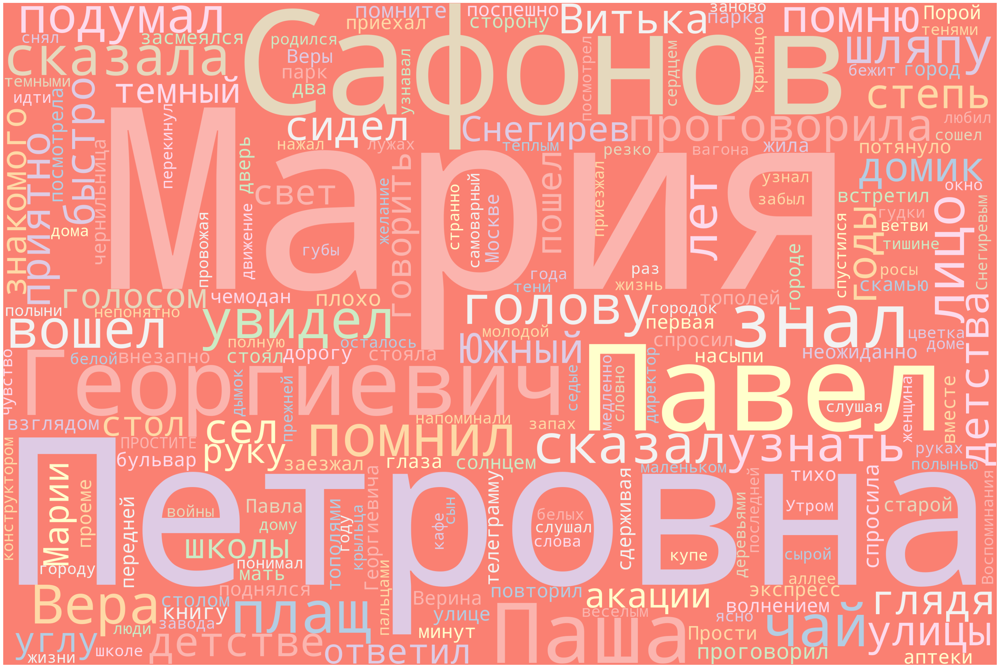

In [13]:
import re 
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS 
with open("Forgive_us!.txt", encoding="utf-8") as file:
    text = file.read()
# Clean text 
text = re.sub(r'==.*?==+', '', text) 
text = text.replace('\n', '') 
# Define a function to plot word cloud 
def plot_cloud(wordcloud): 
    # Set figure size 
    plt.figure(figsize=(40, 30)) 
    # Display image 
    plt.imshow(wordcloud)  
    # No axis details 
    plt.axis("off") 
# Generate word cloud 
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(filtered_text) 
plot_cloud(wordcloud)

SOMETHING

In [26]:
with open("Neprotivlenie.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized

['Юрий',
 'Бондарев',
 'Непротивление',
 'Часть',
 'первая',
 'Глава',
 'первая',
 'Он',
 'протиснулся',
 'сквозь',
 'гущу',
 'людей',
 ',',
 'сквозь',
 'смешанный',
 'гул',
 'голосов',
 ',',
 'крики',
 ',',
 'смех',
 ',',
 'грубую',
 'ругань',
 ',',
 'визгливые',
 'звуки',
 'шарманок',
 ',',
 'всхлипы',
 ',',
 'переборы',
 'аккордеонов',
 'и',
 'хриплые',
 'солдатские',
 'песни',
 ',',
 'сквозь',
 'сплошной',
 'вой',
 'этой',
 'пахнущей',
 'нездоровым',
 'потом',
 'толпы',
 ',',
 'хаотично',
 'толкающейся',
 ',',
 'сжатой',
 'в',
 'каком-то',
 'сумасшедшем',
 'круговороте',
 ',',
 'торгующей',
 'всем',
 ',',
 'чем',
 'можно',
 'было',
 'торговать',
 ',',
 '—',
 'от',
 'буханки',
 'хлеба',
 ',',
 'немецкого',
 'шоколада',
 ',',
 'русской',
 'водки',
 'до',
 'армейских',
 'сапог',
 ',',
 'кальсон',
 'и',
 'американских',
 'презервативов',
 '—',
 'он',
 'вырвался',
 'из',
 'этого',
 'стадного',
 'движения',
 'рынка',
 'и',
 ',',
 'оправляя',
 'едва',
 'не',
 'сорванный',
 'теснотой',
 'т

In [27]:
tagged = nltk.pos_tag(tokenized)
tagged

[('Юрий', 'JJ'),
 ('Бондарев', 'NNP'),
 ('Непротивление', 'NNP'),
 ('Часть', 'NNP'),
 ('первая', 'NNP'),
 ('Глава', 'NNP'),
 ('первая', 'NNP'),
 ('Он', 'NNP'),
 ('протиснулся', 'NNP'),
 ('сквозь', 'NNP'),
 ('гущу', 'NNP'),
 ('людей', 'NNP'),
 (',', ','),
 ('сквозь', 'NNP'),
 ('смешанный', 'NNP'),
 ('гул', 'NNP'),
 ('голосов', 'NNP'),
 (',', ','),
 ('крики', 'NNP'),
 (',', ','),
 ('смех', 'NNP'),
 (',', ','),
 ('грубую', 'NNP'),
 ('ругань', 'NNP'),
 (',', ','),
 ('визгливые', 'NNP'),
 ('звуки', 'NNP'),
 ('шарманок', 'NNP'),
 (',', ','),
 ('всхлипы', 'NNP'),
 (',', ','),
 ('переборы', 'NNP'),
 ('аккордеонов', 'NNP'),
 ('и', 'NNP'),
 ('хриплые', 'NNP'),
 ('солдатские', 'NNP'),
 ('песни', 'NNP'),
 (',', ','),
 ('сквозь', 'NNP'),
 ('сплошной', 'NNP'),
 ('вой', 'NNP'),
 ('этой', 'NNP'),
 ('пахнущей', 'NNP'),
 ('нездоровым', 'NNP'),
 ('потом', 'NNP'),
 ('толпы', 'NNP'),
 (',', ','),
 ('хаотично', 'NNP'),
 ('толкающейся', 'NNP'),
 (',', ','),
 ('сжатой', 'NNP'),
 ('в', 'NNP'),
 ('каком-то', 'J

In [29]:
stemmer = SnowballStemmer(language='russian')
with open("Neprotivlenie.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
stemmed = [stemmer.stem(word) for word in tokenized]
stemmed

['юр',
 'бондар',
 'непротивлен',
 'част',
 'перв',
 'глав',
 'перв',
 'он',
 'протиснул',
 'сквоз',
 'гущ',
 'люд',
 ',',
 'сквоз',
 'смеша',
 'гул',
 'голос',
 ',',
 'крик',
 ',',
 'смех',
 ',',
 'груб',
 'руган',
 ',',
 'визглив',
 'звук',
 'шарманок',
 ',',
 'всхлип',
 ',',
 'перебор',
 'аккордеон',
 'и',
 'хрипл',
 'солдатск',
 'песн',
 ',',
 'сквоз',
 'сплошн',
 'во',
 'эт',
 'пахнущ',
 'нездоров',
 'пот',
 'толп',
 ',',
 'хаотичн',
 'толка',
 ',',
 'сжат',
 'в',
 'каком-т',
 'сумасшедш',
 'круговорот',
 ',',
 'торг',
 'всем',
 ',',
 'чем',
 'можн',
 'был',
 'торгова',
 ',',
 '—',
 'от',
 'буханк',
 'хлеб',
 ',',
 'немецк',
 'шоколад',
 ',',
 'русск',
 'водк',
 'до',
 'армейск',
 'сапог',
 ',',
 'кальсон',
 'и',
 'американск',
 'презерватив',
 '—',
 'он',
 'вырва',
 'из',
 'эт',
 'стадн',
 'движен',
 'рынк',
 'и',
 ',',
 'оправл',
 'едв',
 'не',
 'сорва',
 'теснот',
 'толп',
 'кител',
 ',',
 'с',
 'облегчен',
 'останов',
 'за',
 'палатк',
 'на',
 'кра',
 'тротуар',
 ',',
 'в',
 '

In [ ]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Neprotivlenie.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized
morph.parse(text)

In [30]:
with open("Neprotivlenie.txt", encoding="utf-8") as file:
    text = file.read()
tokenizer = Tokenizer()
tokens = tokenizer.tokenizer(text)
print(tokens)
m=Mystem()
m.analyze('Глава первая Он протиснулся сквозь гущу людей, сквозь смешанный гул голосов, крики, смех, грубую ругань, визгливые звуки шарманок, всхлипы, переборы аккордеонов и хриплые солдатские песни, сквозь сплошной вой этой пахнущей нездоровым потом толпы, хаотично толкающейся, сжатой в каком-то сумасшедшем круговороте, торгующей всем, чем можно было торговать, — от буханки хлеба, немецкого шоколада, русской водки до армейских сапог, кальсон и американских презервативов — он вырвался из этого стадного движения рынка и, оправляя едва не сорванный теснотой толпы китель, с облегчением остановился за палатками на краю тротуара, в тени под липами. Здесь тротуар и мостовая были засыпаны мусором, отбросами, обрывками газет, осколками бутылок, пустыми ящиками, смятыми папиросными коробками, заляпаны мякотью разбитых арбузов, размазней раздавленных помидоров. Было знойно, душно, послеобеденное солнце нещадно давило на гудевшее месиво людей, и здесь, за палатками, жидкая тень от лип не освежала потного лица, несло от мусора горячей вонью ржавой рыбы, гниющим тряпьем, — и Александру даже расхотелось курить. Он все-таки нащупал папиросу в кармане, кинул ее в рот и вошел в забегаловку на другой стороне улицы, переполненную в этот час до отказа. — Доброго здоровьица! Огонька, а? Кто-то, с клоунской ловкостью выкинув руку перед ним, чиркнул зажигалкой, и он увидел полоумно сморщенное подобием улыбки лицо паренька, похожего по растопыренным безмятежным глазам на юродивого, которые встречались на рынке возле шарманок. Александр прикурил. — Привет, друг. Как сегодня Ираидочка? Зверь или кошечка? — Дикобраз, единорог, — хихикнул паренек. — Угости, богатый офицер, «Беломором». — Держи. Кто тебе сказал, что я богат? Кислый, махорочный дым плавал в галдевшей пивной, изгибался толстыми удавами в полосах солнца над деревянными залитыми столами, окруженными парнями в старых гимнастерках, потертых кителях, плыл над стойкой, над рыжей крашеной головой толстой Ираиды, которая по-мужски держала в углу неумеренно накрашенных губ дымящуюся папиросу и, прищуря один глаз, сердито пересчитывала на блюдечке влажные рубли — сдачу какому-то тщедушному пареньку в очках, длинные волосы которого по-поповски лежали на воротнике куртки. — Ирочка, — фальшиво-ласково заговорил Александр с мужеподобной продавщицей, то и дело озирающей пивную выпуклыми глазами, обведенными краснотой век. — Ираида, — повторил он еще ласковее, — я сегодня без копья. Если не жаль, то прошу, ласточка, порцию сосисок и кружку пива в долг. Завтра верну. — Какая я тебе, к едреной матери, ласточка? Ишь птичку нашел! — грубо фыркнула малиновыми губами Ираида и грозно глянула вороньим взором. — Не подкатывайся зря! Сегодня все задарма лезут! Прогорю я с вами, дьяволами! С утра оккупировали пивную, а толку от вас — ни хрена! — Ирка, заткнись! Дай парню выпить! Эльдар, одолжи воину гроши! — раздался голос из глубины пивной. Длинноволосый парень покосился на Александра из-под очков, уже забирая сдачу, но тут же с ухмылкой бросил деньги обратно на блюдечко, сказал певуче: — Так пусть будет еще кружка пива и еще сосиски. — Ты из каких краев такой добрый? — насмешливо спросил Александр, оглядываясь на столики, откуда раздался приказывающий голос. — И кто это тобой командует? — Он взял тарелку с сосисками, кружку, кипевшую пеной, и, расставив локти, чтобы не толкнули, двинулся к столикам вместе с длинноволосым. — Заворачивай сюда! Ставь закусон и пойло! — крикнул плотный парень в гимнастерке, с щетинистыми усами и ладонью махнул по столу, отодвигая пустые стаканы и кружки. — Садись, кореш, соседом! А ну, давай, давай, телись, возишься, как на свадьбе, монах патлатый! — Он почти вырвал стакан и кружку у длинноволосого, отхлебнул из стакана, запил водку жадными глотками пива, мотнул головой на Александра. — А ты чего не пьешь? — Чокнуться хотел, — сказал Александр. — Ох ты, какой интеллигентный. — Да так как-то вроде поудобней, если приглашаешь сесть рядом. — Давай чокнемся, коли охота есть. Твердая рука с черной каемкой под широкими ногтями немного дрожала, но так крепко охватывала граненый стакан, что, казалось, стекло могло лопнуть. Кольнув остренькими точками крошечных глаз в самые зрачки Александра, парень чересчур сильно ударил стаканом в его кружку, так что выплеснулась водка, сказал: — Я есть Гришка Логачев. Слышал такого в Замоскворечье? Слышал небось? Александр отпил пахнущее железом пиво. — Слышал. — Что слышал? — Если ты тот самый довоенный Гришка Логачев, то значит — голубятник и вор. — Цыть, сволочь! Гришка ребром ладони врезал по грязному столу, подскочили стаканы, пролившееся пиво поползло по кружке. — Не цыкай, а то начну заикаться. Очень испугал. Логачев ухмыльнулся. — Силен, видать. Давно прибыл? Где грязь месил? На каких фронтах? — Первый Украинский. Полковая разведка. А что? — До каких чинов долез? — Лейтенант, — ответил неохотно Александр. — А что за интерес? Мы где — в пивной или в отделе кадров? Может, анкету еще тебе заполнить: воевал ли у белых, состоял ли в оппозициях, есть ли в семье репрессированные? — Цыть! — опять стукнул ребром ладони Логачев. — Нишкни! Александр поднялся, предупредил тихо: — Еще раз цыкнешь, дам в морду. Логачев привстал, с нескрываемым интересом в упор разглядывал Александра, облизнул щетинистые усы и снова сел. — Ладно. Давай пить, — сказал пьяно и примирительно. — Не в ту сторону поперли. А ты вроде, парень, ежик, а? Давай, пей, братва, — обратился он к двум парням за столом, которые молчали во время разговора Логачева и Александра. — Эльдар, принеси-ка еще всем по стакашку с прицепом. Он кинул длинноволосому розовые потертые тридцатки и впился крупными губами в край кружки, покряхтывая от удовольствия, обсасывая пивную пену с усов. Пока длинноволосый носил от стойки кружки и стаканы, выполняя в этой компании роль официанта, Александр рассмотрел соседей по столу. Напротив него сидел худощавый, тонколицый парень в кремовом, безупречно сшитом заграничном пиджаке с четырьмя орденскими планками на узком лацкане, светлые волосы лежали на красивом лбу колечками, делая его голову как бы кудрявой, задымленные веселой дерзостью глаза полуулыбались Александру. Кудрявый неторопливо отпивал пиво и, вроде забавляясь, поигрывал в руке маленькой трофейной финочкой, совсем игрушечной, изящной, с зеркальным лезвием. Слева от кудрявого сидел мрачноватый парень в летней добела выгоревшей гимнастерке, распиравшей крутые плечи, его угрюмо-непроницаемые глаза будто дремали: ни водка, ни пиво не возбуждали его, прижатые уши, ежик волос делали его похожим на боксера. Он равнодушно сунул лопатообразную руку в сторону Александра и так стиснул его пальцы, что суставы хрустнули. — Зови Миша. Только не лейтенант, а старшина. Гвардейские минометы, — сказал он скучно. — Значит, разведка? — спросил кудрявый, поигрывая финочкой. — Конная или пешая? — Пешая. — Выражаю сожаление. — Это почему же? — Люблю лошадей — На здоровье. — Остри в другом месте, шуток не принимаю, — дерзкие глаза парня продолжали улыбаться, но тонкие губы передернулись. — Представляюсь, разведчик: бывший командир противотанковой батареи на конной тяге старший лейтенант Аркадий Кирюшкин. От Сталинграда до Зееловских. Понял, почему лошадь друг человека. В солнечных полосах махорочный и папиросный дым фиолетовыми кольцами шевелился, перекручивался под потолком, голоса переполненной забегаловки гудели шмелиным гудом, пахло затхлой одеждой, горьковатой кислотой пива, сивушным духом водки; дверь хлопала, впуская новых посетителей, торгашей Дубинского рынка, в тесноте кое-кто из рыночных начал проталкиваться к столу, где было два свободных места, однако, заметив играющую блеском финочку в руке Кирюшкина, угрюмые глаза, ежик волос «боксера», молча оттирались в сторону. Кирюшкин повторил спокойным голосом: — Лошадь — друг человека, кореш. Вместе были на передовой. За соседним столом кто-то засмеялся с полным ртом: — А собака — не друг разве? Сообразил, что в лужу треснул! Кирюшкин нехотя повернул кудрявую голову, не без удивления оглянул толстощекое лицо соседа, одетого в клетчатую ковбойку, истово жующего сосиску, поинтересовался: — Это ты такой хохотальный мужчина? — А что? — Заткни подштанниками глотку, барыга. — С какой это еще стати? — толстощекий перестал жевать, лицо стало сизо-багровым. — Ты кто такой здесь есть, что с ножиком балуешься? Вокруг поубавился шум, замолкли голоса, потом ветерком прошелестело по столам пивной: «Это же Кирюшкин, что он, дурак мордастый, с ним связался?» А Кирюшкин, суживая светлые глаза, продолжая играть финочкой меж тонких пальцев, еле приметно кивнул «боксеру». И тот, приоткрыв опухшие веки, по-медвежьи встал и, невнятно бормоча, что спекулянтские тыловые крысы его раздражают, не дают культурно отдохнуть, почти не глядя, легко поднял за шиворот толстощекого, рывком вытащил из-за стола. Затем бесцеремонно протиснул его сквозь толпу к выходу, вытолкнул за порог, головой толстощекого распахнув дверь. Там, за дверью, пискнуло: «Милиция», — и сейчас же стихло. Никто в забегаловке не сказал ни слова, только посторонились, когда «боксер» вернулся к столу и без всякого удовольствия на мрачноватом лице округлил и опустил брови, этим выражая удовлетворение расторопностью длинноволосого, успевшего каждому принести еще по кружке пива и стакану водки. Теперь длинноволосый, обликом похожий на монаха, сидел тихонько за столом, упираясь сухими кулачками в худой подбородок, и смотрел умным, влюбленным, укоряющим взором на Кирюшкина, а он с независимым спокойствием приводил финочкой в порядок ногти. Третий, тот, который пригласил Александра к столу, посасывал пиво, как если бы ничего не случилось. Было видно, что их знают здесь, в этой прирыночной забегаловке, и побаиваются. Александр подумал, почему-то не удивляясь своей доверчивости:')

['Юрий', 'Бондарев', 'Непротивление', 'Часть', 'первая', 'Глава', 'первая', 'Он', 'протиснулся', 'сквозь', 'гущу', 'людей', 'сквозь', 'смешанный', 'гул', 'голосов', 'крики', 'смех', 'грубую', 'ругань', 'визгливые', 'звуки', 'шарманок', 'всхлипы', 'переборы', 'аккордеонов', 'и', 'хриплые', 'солдатские', 'песни', 'сквозь', 'сплошной', 'вой', 'этой', 'пахнущей', 'нездоровым', 'потом', 'толпы', 'хаотично', 'толкающейся', 'сжатой', 'в', 'какомто', 'сумасшедшем', 'круговороте', 'торгующей', 'всем', 'чем', 'можно', 'было', 'торговать', '—', 'от', 'буханки', 'хлеба', 'немецкого', 'шоколада', 'русской', 'водки', 'до', 'армейских', 'сапог', 'кальсон', 'и', 'американских', 'презервативов', '—', 'он', 'вырвался', 'из', 'этого', 'стадного', 'движения', 'рынка', 'и', 'оправляя', 'едва', 'не', 'сорванный', 'теснотой', 'толпы', 'китель', 'с', 'облегчением', 'остановился', 'за', 'палатками', 'на', 'краю', 'тротуара', 'в', 'тени', 'под', 'липами', 'Здесь', 'тротуар', 'и', 'мостовая', 'были', 'засыпаны',

[{'analysis': [{'lex': 'глава', 'wt': 0.5182047872, 'gr': 'S,муж,од=им,ед'}],
  'text': 'Глава'},
 {'text': ' '},
 {'analysis': [{'lex': 'первый', 'wt': 1, 'gr': 'ANUM=им,ед,жен'}],
  'text': 'первая'},
 {'text': ' '},
 {'analysis': [{'lex': 'он', 'wt': 1, 'gr': 'SPRO,ед,3-л,муж=им'}],
  'text': 'Он'},
 {'text': ' '},
 {'analysis': [{'lex': 'протискиваться',
    'wt': 1,
    'gr': 'V,нп=прош,ед,изъяв,муж,сов'}],
  'text': 'протиснулся'},
 {'text': ' '},
 {'analysis': [{'lex': 'сквозь', 'wt': 1, 'gr': 'PR='}], 'text': 'сквозь'},
 {'text': ' '},
 {'analysis': [{'lex': 'гуща', 'wt': 0.9992058835, 'gr': 'S,жен,неод=вин,ед'}],
  'text': 'гущу'},
 {'text': ' '},
 {'analysis': [{'lex': 'человек', 'wt': 1, 'gr': 'S,муж,од=(вин,мн|род,мн)'}],
  'text': 'людей'},
 {'text': ', '},
 {'analysis': [{'lex': 'сквозь', 'wt': 1, 'gr': 'PR='}], 'text': 'сквозь'},
 {'text': ' '},
 {'analysis': [{'lex': 'смешанный',
    'wt': 0.7982878112,
    'gr': 'A=(вин,ед,полн,муж,неод|им,ед,полн,муж)'}],
  'text': 'с

In [16]:
import spacy

def remove_stopwords(text):
    nlp = spacy.load('ru_core_news_sm')
    doc = nlp(text)
    words = [token.text for token in doc if not token.is_stop and token.pos_ not in {'ADP', 'PRON', 'PART'}]
    filtered_text = ' '.join(words)

    return filtered_text


with open("Neprotivlenie.txt", encoding="utf-8") as file:
    text = file.read()
filtered_text = remove_stopwords(text)
print(filtered_text)

Юрий Бондарев 
 Непротивление 
 Часть первая 
 Глава первая 
    протиснулся гущу людей , смешанный гул голосов , крики , смех , грубую ругань , визгливые звуки шарманок , всхлипы , переборы аккордеонов хриплые солдатские песни , сплошной вой пахнущей нездоровым толпы , хаотично толкающейся , сжатой каком - сумасшедшем круговороте , торгующей , торговать , — буханки хлеба , немецкого шоколада , русской водки армейских сапог , кальсон американских презервативов — вырвался стадного движения рынка , оправляя сорванный теснотой толпы китель , облегчением остановился палатками краю тротуара , тени липами . тротуар мостовая засыпаны мусором , отбросами , обрывками газет , осколками бутылок , пустыми ящиками , смятыми папиросными коробками , заляпаны мякотью разбитых арбузов , размазней раздавленных помидоров . знойно , душно , послеобеденное солнце нещадно давило гудевшее месиво людей , , палатками , жидкая тень лип освежала потного лица , несло мусора горячей вонью ржавой рыбы , гниющим тря

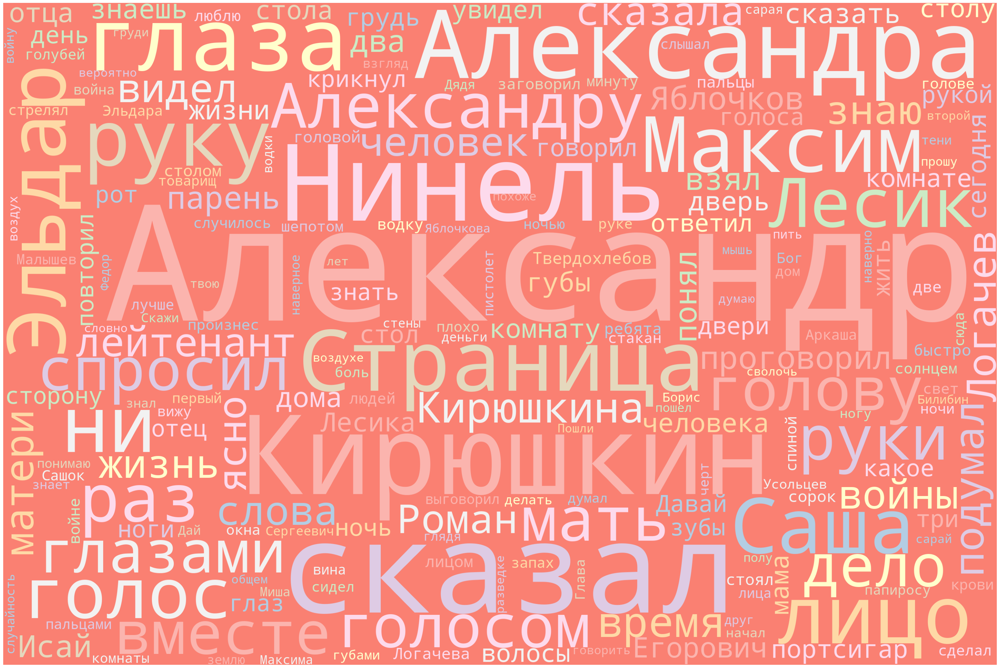

In [17]:
import re 
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS 
with open("Neprotivlenie.txt", encoding="utf-8") as file:
    text = file.read()
# Clean text 
text = re.sub(r'==.*?==+', '', text) 
text = text.replace('\n', '') 
# Define a function to plot word cloud 
def plot_cloud(wordcloud): 
    # Set figure size 
    plt.figure(figsize=(40, 30)) 
    # Display image 
    plt.imshow(wordcloud)  
    # No axis details 
    plt.axis("off") 
# Generate word cloud 
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(filtered_text) 
plot_cloud(wordcloud)

Something

In [33]:
with open("Relatives.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized

['Юрий',
 'Бондарев',
 'РОДСТВЕННИКИ',
 '1',
 'Он',
 'открыл',
 'глаза',
 ',',
 'увидел',
 'чужую',
 'комнату',
 ',',
 'до',
 'горячей',
 'духоты',
 'нагретую',
 'солнцем',
 ',',
 'и',
 'почувствовал',
 ',',
 'как',
 'потное',
 'лицо',
 'овеивало',
 'слабым',
 'дуновением',
 'воздуха',
 '.',
 'В',
 'раскрытое',
 'окно',
 'тек',
 'сухой',
 'жар',
 'июльского',
 'утра',
 '.',
 'Прямо',
 'над',
 'головой',
 'на',
 'самом',
 'солнцепеке',
 ',',
 'за',
 'подоконником',
 ',',
 'постукивали',
 'когтями',
 'по',
 'карнизу',
 'сизые',
 'голуби',
 'и',
 'в',
 'поисках',
 'тени',
 'заглядывали',
 'в',
 'комнату',
 '.',
 'Потом',
 'он',
 'услышал',
 ',',
 'как',
 'где-то',
 'в',
 'глубине',
 'двора',
 'с',
 'напором',
 'зашелестели',
 'струи',
 'воды',
 'о',
 'листву',
 ',',
 'невнятные',
 'послышались',
 'голоса',
 ',',
 'заработал',
 'на',
 'холостых',
 'оборотах',
 'мотор',
 'поливальной',
 'машины',
 '.',
 '«',
 'Что',
 'это',
 ',',
 'где',
 'я',
 '?',
 '—',
 'подумал',
 'Никита',
 ',',
 'выти

In [34]:
tagged = nltk.pos_tag(tokenized)
tagged

[('Юрий', 'JJ'),
 ('Бондарев', 'NNP'),
 ('РОДСТВЕННИКИ', 'NNP'),
 ('1', 'CD'),
 ('Он', 'NNP'),
 ('открыл', 'NNP'),
 ('глаза', 'NNP'),
 (',', ','),
 ('увидел', 'NNP'),
 ('чужую', 'NNP'),
 ('комнату', 'NNP'),
 (',', ','),
 ('до', 'NNP'),
 ('горячей', 'NNP'),
 ('духоты', 'NNP'),
 ('нагретую', 'NNP'),
 ('солнцем', 'NNP'),
 (',', ','),
 ('и', 'NNP'),
 ('почувствовал', 'NNP'),
 (',', ','),
 ('как', 'NNP'),
 ('потное', 'NNP'),
 ('лицо', 'NNP'),
 ('овеивало', 'NNP'),
 ('слабым', 'NNP'),
 ('дуновением', 'NNP'),
 ('воздуха', 'NNP'),
 ('.', '.'),
 ('В', 'VB'),
 ('раскрытое', 'JJ'),
 ('окно', 'NNP'),
 ('тек', 'NNP'),
 ('сухой', 'NNP'),
 ('жар', 'NNP'),
 ('июльского', 'NNP'),
 ('утра', 'NNP'),
 ('.', '.'),
 ('Прямо', 'VB'),
 ('над', 'JJ'),
 ('головой', 'NNP'),
 ('на', 'NNP'),
 ('самом', 'NNP'),
 ('солнцепеке', 'NNP'),
 (',', ','),
 ('за', 'NNP'),
 ('подоконником', 'NNP'),
 (',', ','),
 ('постукивали', 'NNP'),
 ('когтями', 'NNP'),
 ('по', 'NNP'),
 ('карнизу', 'NNP'),
 ('сизые', 'NNP'),
 ('голуби', '

In [35]:
stemmer = SnowballStemmer(language='russian')
with open("Relatives.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
stemmed = [stemmer.stem(word) for word in tokenized]
stemmed

['юр',
 'бондар',
 'родственник',
 '1',
 'он',
 'откр',
 'глаз',
 ',',
 'увидел',
 'чуж',
 'комнат',
 ',',
 'до',
 'горяч',
 'духот',
 'нагрет',
 'солнц',
 ',',
 'и',
 'почувствова',
 ',',
 'как',
 'потн',
 'лиц',
 'овеива',
 'слаб',
 'дуновен',
 'воздух',
 '.',
 'в',
 'раскрыт',
 'окн',
 'тек',
 'сух',
 'жар',
 'июльск',
 'утр',
 '.',
 'прям',
 'над',
 'голов',
 'на',
 'сам',
 'солнцепек',
 ',',
 'за',
 'подоконник',
 ',',
 'постукива',
 'когт',
 'по',
 'карниз',
 'сиз',
 'голуб',
 'и',
 'в',
 'поиск',
 'тен',
 'заглядыва',
 'в',
 'комнат',
 '.',
 'пот',
 'он',
 'услыша',
 ',',
 'как',
 'где-т',
 'в',
 'глубин',
 'двор',
 'с',
 'напор',
 'зашелестел',
 'стру',
 'вод',
 'о',
 'листв',
 ',',
 'невнятн',
 'послыша',
 'голос',
 ',',
 'заработа',
 'на',
 'холост',
 'оборот',
 'мотор',
 'поливальн',
 'машин',
 '.',
 '«',
 'что',
 'эт',
 ',',
 'где',
 'я',
 '?',
 '—',
 'подума',
 'никит',
 ',',
 'вытир',
 'испарин',
 'на',
 'груд',
 '.',
 '—',
 'я',
 'не',
 'дом',
 '?',
 'мам',
 'умерл',
 '—

In [39]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Relatives.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized
morph.parse(text)

[Parse(word='юрий бондарев\nродственники\n1\n   он открыл глаза, увидел чужую комнату, до горячей духоты нагретую солнцем, и почувствовал, как потное лицо овеивало слабым дуновением воздуха. в раскрытое окно тек сухой жар июльского утра. прямо над головой на самом солнцепеке, за подоконником, постукивали когтями по карнизу сизые голуби и в поисках тени заглядывали в комнату. потом он услышал, как где-то в глубине двора с напором зашелестели струи воды о листву, невнятные послышались голоса, заработал на холостых оборотах мотор поливальной машины.\n   «что это, где я? — подумал никита, вытирая испарину на груди. — я не дома? мама умерла — и я здесь?..»\n   во время сна ему припекло голову, звенело в ушах, и была неприятная расслабленность в замлевших мускулах: он спал всю ночь в неудобном положении, лицом вниз, сжав руки на груди. весь мокрый от пота, никита с отвращением сбросил прилипшую к телу простыню, опустил ноги с дивана и огляделся.\n   в комнате этой, видимо, не жили давно: ста

In [38]:
with open("Relatives.txt", encoding="utf-8") as file:
    text = file.read()
tokenizer = Tokenizer()
tokens = tokenizer.tokenizer(text)
print(tokens)
m=Mystem()
m.analyze('Он открыл глаза, увидел чужую комнату, до горячей духоты нагретую солнцем, и почувствовал, как потное лицо овеивало слабым дуновением воздуха. В раскрытое окно тек сухой жар июльского утра. Прямо над головой на самом солнцепеке, за подоконником, постукивали когтями по карнизу сизые голуби и в поисках тени заглядывали в комнату. Потом он услышал, как где-то в глубине двора с напором зашелестели струи воды о листву, невнятные послышались голоса, заработал на холостых оборотах мотор поливальной машины. «Что это, где я? — подумал Никита, вытирая испарину на груди. — Я не дома? Мама умерла — и я здесь?..» Во время сна ему припекло голову, звенело в ушах, и была неприятная расслабленность в замлевших мускулах: он спал всю ночь в неудобном положении, лицом вниз, сжав руки на груди. Весь мокрый от пота, Никита с отвращением сбросил прилипшую к телу простыню, опустил ноги с дивана и огляделся. В комнате этой, видимо, не жили давно: старые обои дожелта выгорели, было не прибрано, тесно от потертых кожаных кресел, от просиженных стульев меж расставленных по стенам тумбочек, от неуютных, загромоздивших углы книжных шкафов; пахло от дивана теплой и горьковатой пылью. А незнакомая квартира за дверями, казалось, была выжжена горячим солнцем: было уже полное утро, но никто не стучал, не входил к нему. И все-таки там, за дверью, кто-то затаенно и тихо сейчас передвигался в коридоре, шепотом разговаривал по телефону, и Никита догадывался, что шептались, говорили о нем, о смерти матери, и растерянно взглянул на себя в зеркало над диваном. В пыльной желтой его глубине замерло бледное, заспанное лицо с красной на щеке полосой от подушки, серые глаза всматривались вопросительно. Никита провел по щекам пальцами и отдернул руку. Он представил, что такое же выражение, наверно, было на его лице и вчера, когда после приезда из Ленинграда он сидел за столом в окружении незнакомых, сочувствующих ему людей, когда, на чей-то вопрос глухо ответил, что мать в больнице ничего не просила, даже не жаловалась на боли, хотя умирала в сознании. И по тому, как они подолгу, с горьким участием смотрели в его сторону, он подумал, что все эти люди, скованно ужинавшие вчера в длинной, старомодной столовой, были или его родственники, или знакомые его матери — он всех их видел впервые. В середине ужина хозяин дома профессор Георгий Лаврентьевич Греков отрывисто и нервно покашлял в ладонь, проговорил, ни к кому не обращаясь: «Да, она была мужественной женщиной», — и сейчас же излишне решительной походкой, свойственной часто людям маленького роста, вышел из столовой. После его ухода никто за столом не проронил ни слова, все, по-прежнему склонясь над тарелками, с каким-то опасливым пониманием постукивали вилками, и Никита вопросительно покосился на Ольгу Сергеевну, жену Георгия Лаврентьевича. Весь ужин она сидела в скорбном молчании, неспокойными пальцами комкая салфетку; в пунцовых мочках ее ушей, покачиваясь, сверкали серьги, молодили ее когда-то красивое, теперь уже полнеющее лицо. Поймав его взгляд, она с ласковой сдержанностью тронула его руку, сказала вполголоса: — Вы, кажется, устали, Никита? Вы, очевидно, плохо спали в вагоне. Если не возражаете, я покажу вам комнату. Тогда он поднялся, проговорил, ни на кого не глядя: «До свидания», — и последовал за ней, ощущая взгляды на своей спине. И как только закрыл дверь комнаты, непроницаемое безмолвие затопило квартиру: чудилось, гости разошлись из столовой на цыпочках, и не слышно было, как прощались они. «Что они говорят обо мне? — вспомнив свой приезд, хмурясь, подумал Никита и прислушался. — Почему они не входят, не стучат, а стоят в коридоре? И кто жил в этой комнате? Чьи это боксерские перчатки? Что я должен делать теперь?» Он встал с дивана, долго смотрел на тренировочную грушу, висевшую в углу, на затянутые слоем пыли боксерские перчатки (они валялись на стуле). Перчатки ссохлись, покоробились — лежали здесь давно. Он тихонько сдул с них пыль, натянул корявую, до скрипа прокаленную солнцем перчатку на правую руку и, не зная зачем, слабо ударил по груше. Она с тупым звуком метнулась на подвеске, закачалась. Никита ударил еще раз и, стиснув зубы, стоял, ожидая. Было тихо, в окно веяло запахом накаленных крыш. В дверь внезапно постучали. Никита стряхнул, отбросил в угол перчатку, стал, торопясь, натягивать ковбойку. — Простите… Доброе утро, Никита. Можно к вам? — И осторожно вошла Ольга Сергеевна, послышался свистящий шорох ее платья. — Простите, ради бога, Никита, я вас не разбудила?.. Не подымая головы, он все торопливо искал пуговицы на ковбойке. И, не отвечая ей, видел совсем рядом ее освещенные солнцем полные колени, выступавшие под коротким белым платьем, ее сильные, с высоким подъемом ноги, золотистые волоски на них, будто высветленные солнечными лучами. — Какое же это несчастье, какое несчастье!.. — негромко заговорила Ольга Сергеевна. — Поверьте, я понимаю ваше состояние. Потерять мать… Господи, как я это все понимаю! Я сама это пережила три года назад. Ольга Сергеевна так близко стояла перед ним, что он явственно вдыхал терпковато-теплый запах ее платья. Она вдруг неуверенно и робко погладила его по голове, от ее руки повеяло свежим запахом земляничного мыла, и он мгновенно ощутил свои жесткие волосы, еще не причесанные, и, дернув головой, сказал шепотом: — Спасибо, Ольга Сергеевна, не надо… — Я понимаю, Никита. Я все понимаю. Она, умытая после сна, всматривалась в него, глаза были размягчены состраданием, жалостью; белое летнее платье — такие никогда не носила мать — стягивало ее торчащую грудь, чистые каштановые волосы убраны в пучок на затылке, в алых мочках прижатых ушей поблескивали серьги. — Бедный, бедный, — сочувственно отыскивая глазами его взгляд, проговорила Ольга Сергеевна, и ее пальцы щекотно прикоснулись к его груди, помогая ему застегнуть пуговицу. — Вы все время думаете о ней? Я тоже никогда не забуду ту страшную потерю. Никита угрюмо глядел в пол, на рассохшийся, старый паркет, отчетливо видел завязший в пыли голубиный пух, грязные пятна раздавленного пепла, точно несколько лет никто не входил в эту заброшенную комнату. Еле слышно спросил: — Он… тоже умер? Боксерские перчатки… Это его? Она отошла на шаг, подняла полные оголенные руки к измененному испугом липу. — Нет, нет! Это комната сына… Он только не живет у нас! У него семья… Вы меня не так поняли! Три года назад, Никита, я тоже пережила смерть матери. Господи боже мой, какая нелепость! — вскрикнула Ольга Сергеевна и опустилась в кресло, прикрыла рукой лоб. — Как мы все стали суеверны! Какая нелепость! — Простите, я не знал, — пробормотал Никита. — Я подумал только, когда вы сказали… Вздохнув, Ольга Сергеевна отняла пальцы ото лба и через силу закивала ему. — Я понимаю вас. Как все это невыносимо! Он молчал. — Да, да… Я хотела вам сказать, Георгий Лаврентьевич придет из института в первом часу, — проговорила Ольга Сергеевна утомленно. — Он хочет сегодня встретиться с вами. Обязательно. — Спасибо, Ольга Сергеевна. — Через полчаса я вас жду к завтраку, Никита. — Спасибо. Я не хочу. — Но так нельзя. Вы должны есть. Вы же ослабнете, Никита. Я вас жду к завтраку! Она вышла. Тихая жаркая пустота была в комнате. Ни звука, ни шороха не доносилось из квартиры. Он лег на диван. И тут вся стена перед ним, с унылыми вензелями обоев, теплая, прямая, покрытая пушком пыли, слилась во что-то однообразно-серое, душное, бессмысленное, и он испугался, что в эту минуту может заплакать. — Очень хочу с вами поговорить, оч-чень!.. Вчера, к сожалению, не смог. Да и вы были только с поезда. Да, теперь мы сможем! Георгий Лаврентьевич Греков ходил по кабинету нервной, танцующей какой-то походкой, странной при его широких плечах, крупной голове и маленьком росте; подпоясанный халат был длинен, извиваясь, мотался над голыми щиколотками. И было странно видеть среди этого просторного, залитого солнцем кабинета с высокими старинными книжными шкафами по четырем стенам его подрагивающие, обнаженные ноги в домашних шлепанцах. Они быстро двигались, мелькали по ковру. — Оч-чень хочу! — повторил Георгий Лаврентьевич. — Да, я хочу с вами поговорить! Садитесь в кресло удобнее. Значит, я ваш родной дядя, а вы мой племянник. Вот при каких горьких обстоятельствах мы с вами встретились, дорогой вы мой! Никита сел в кресло, как бы еще сомневаясь, что этот маленький, широкоплечий, тщательно выбритый, закутанный в халат старик может быть его родственником, его дядей, известным профессором истории, живущим здесь, в Москве. Но, успокаивая себя, он вспомнил адрес на привезенном им письме, слова на конверте «профессору Грекову», написанные и подчеркнутые рукою матери. И, невольно улавливая вчерашнюю настороженность в тоне Грекова и вместе с тем испытывая стыд и отвращение к самому себе после неуклюжего разговора с Ольгой Сергеевной, подумал: «Нет, они не знали, что умерла мать» — Значит, вы приехали? — снова повторил Греков и остановился перед книжным шкафом, приподнялся на цыпочки, забросил руки за спину, хрустнул пальцами. — Как вы спали? Удобно вам было? Вы впервые в Москве? — Спасибо, — сказал Никита, переводя взгляд с домашних, непонятно почему приковывавших внимание профессорских шлепанцев на шевелящиеся в широких рукавах пальцы за спиной, на его седой до нежной серебристости затылок. Греков стоял, выпрямив круглую спину, лицом к книжному шкафу, и показалось Никите, что профессор, в стекло, как в зеркало, наблюдал за ним, похрустывая пальцами. — Так. Значит, это письмо? Письмо… — Да, — сказал Никита. — Да, да, да… Но это могло быть ошибкой, невероятной, страшной ошибкой! — зазвеневшим голосом заговорил Георгий Лаврентьевич, подойдя к двери, задернул портьеру. — Все это может быть ужасной ошибкой!.. — Вы о чем? — не понял Никита. — Нет, никому не сообщить о болезни… Умереть в одиночестве! Надо быть немыслимо сильным человеком! И вы один, конечно, были с ней? И она никого из родственников не хотела видеть в больнице? Георгий Лаврентьевич все шагал по кабинету, по толстому ковру, мимо дубовых книжных шкафов, кожаных кресел; волнами колыхался его длинный халат перед глазами Никиты.')

['Юрий', 'Бондарев', 'РОДСТВЕННИКИ', '1', 'Он', 'открыл', 'глаза', 'увидел', 'чужую', 'комнату', 'до', 'горячей', 'духоты', 'нагретую', 'солнцем', 'и', 'почувствовал', 'как', 'потное', 'лицо', 'овеивало', 'слабым', 'дуновением', 'воздуха', 'В', 'раскрытое', 'окно', 'тек', 'сухой', 'жар', 'июльского', 'утра', 'Прямо', 'над', 'головой', 'на', 'самом', 'солнцепеке', 'за', 'подоконником', 'постукивали', 'когтями', 'по', 'карнизу', 'сизые', 'голуби', 'и', 'в', 'поисках', 'тени', 'заглядывали', 'в', 'комнату', 'Потом', 'он', 'услышал', 'как', 'гдето', 'в', 'глубине', 'двора', 'с', 'напором', 'зашелестели', 'струи', 'воды', 'о', 'листву', 'невнятные', 'послышались', 'голоса', 'заработал', 'на', 'холостых', 'оборотах', 'мотор', 'поливальной', 'машины', '«Что', 'это', 'где', 'я', '—', 'подумал', 'Никита', 'вытирая', 'испарину', 'на', 'груди', '—', 'Я', 'не', 'дома', 'Мама', 'умерла', '—', 'и', 'я', 'здесь»', 'Во', 'время', 'сна', 'ему', 'припекло', 'голову', 'звенело', 'в', 'ушах', 'и', 'была',

[{'analysis': [{'lex': 'он', 'wt': 1, 'gr': 'SPRO,ед,3-л,муж=им'}],
  'text': 'Он'},
 {'text': ' '},
 {'analysis': [{'lex': 'открывать', 'wt': 1, 'gr': 'V=прош,ед,изъяв,муж,сов'}],
  'text': 'открыл'},
 {'text': ' '},
 {'analysis': [{'lex': 'глаз',
    'wt': 1,
    'gr': 'S,муж,неод=(вин,мн|род,ед|им,мн)'}],
  'text': 'глаза'},
 {'text': ', '},
 {'analysis': [{'lex': 'увидеть',
    'wt': 1,
    'gr': 'V,сов,пе=прош,ед,изъяв,муж'}],
  'text': 'увидел'},
 {'text': ' '},
 {'analysis': [{'lex': 'чужой',
    'wt': 0.9913860718,
    'gr': 'A,полн=вин,ед,жен'}],
  'text': 'чужую'},
 {'text': ' '},
 {'analysis': [{'lex': 'комната', 'wt': 1, 'gr': 'S,жен,неод=вин,ед'}],
  'text': 'комнату'},
 {'text': ', '},
 {'analysis': [{'lex': 'до', 'wt': 0.9994975359, 'gr': 'PR='}], 'text': 'до'},
 {'text': ' '},
 {'analysis': [{'lex': 'горячий',
    'wt': 0.9857945983,
    'gr': 'A=(пр,ед,полн,жен|дат,ед,полн,жен|род,ед,полн,жен|твор,ед,полн,жен)'}],
  'text': 'горячей'},
 {'text': ' '},
 {'analysis': [{'

In [18]:
import spacy

def remove_stopwords(text):
    nlp = spacy.load('ru_core_news_sm')
    doc = nlp(text)
    words = [token.text for token in doc if not token.is_stop and token.pos_ not in {'ADP', 'PRON', 'PART'}]
    filtered_text = ' '.join(words)

    return filtered_text


with open("Relatives.txt", encoding="utf-8") as file:
    text = file.read()
filtered_text = remove_stopwords(text)
print(filtered_text)

Юрий Бондарев 
 РОДСТВЕННИКИ 
 1 
    открыл глаза , увидел чужую комнату , горячей духоты нагретую солнцем , почувствовал , потное лицо овеивало слабым дуновением воздуха . раскрытое окно тек сухой жар июльского утра . Прямо головой солнцепеке , подоконником , постукивали когтями карнизу сизые голуби поисках тени заглядывали комнату . услышал , - глубине двора напором зашелестели струи воды листву , невнятные послышались голоса , заработал холостых оборотах мотор поливальной машины . 
    « , ? — подумал Никита , вытирая испарину груди . — дома ? Мама умерла — ? .. » 
    время сна припекло голову , звенело ушах , неприятная расслабленность замлевших мускулах : спал ночь неудобном положении , лицом , сжав руки груди . мокрый пота , Никита отвращением сбросил прилипшую телу простыню , опустил ноги дивана огляделся . 
    комнате , видимо , жили : старые обои дожелта выгорели , прибрано , тесно потертых кожаных кресел , просиженных стульев расставленных стенам тумбочек , неуютных , загр

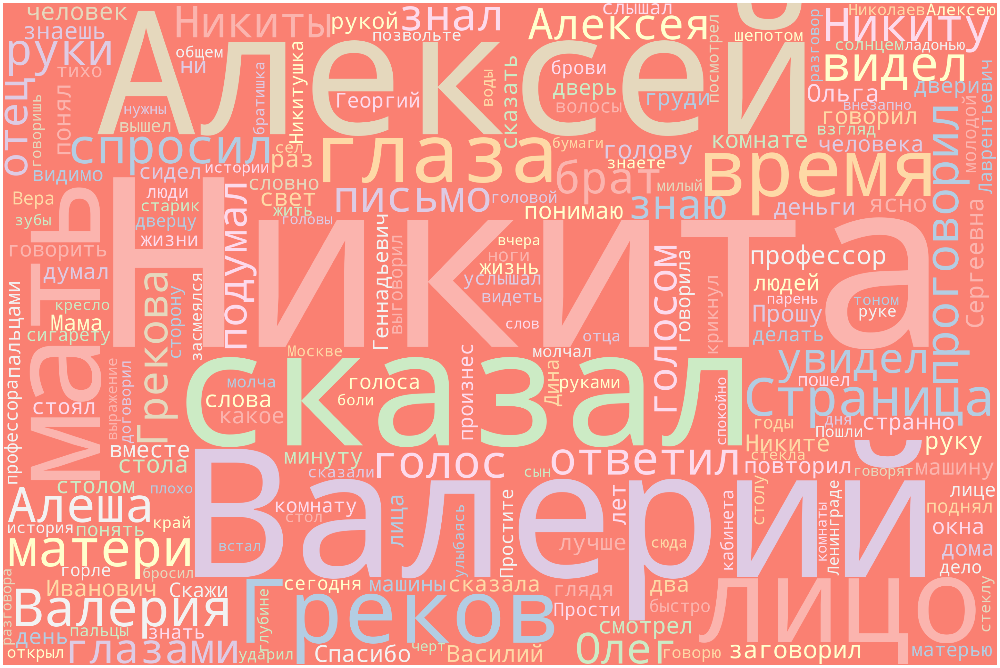

In [19]:
import re 
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS 
with open("Relatives.txt", encoding="utf-8") as file:
    text = file.read()
# Clean text 
text = re.sub(r'==.*?==+', '', text) 
text = text.replace('\n', '') 
# Define a function to plot word cloud 
def plot_cloud(wordcloud): 
    # Set figure size 
    plt.figure(figsize=(40, 30)) 
    # Display image 
    plt.imshow(wordcloud)  
    # No axis details 
    plt.axis("off") 
# Generate word cloud 
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(filtered_text) 
plot_cloud(wordcloud)

Something

In [41]:
with open("Silence.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized

['Юрий',
 'Бондарев',
 'Тишина',
 'ЧАСТЬ',
 'ПЕРВАЯ',
 '.',
 '1945',
 'ГОД',
 '1',
 'Выбиваясь',
 'из',
 'сил',
 ',',
 'он',
 'бежал',
 'посреди',
 'лунной',
 'мостовой',
 'мимо',
 'зияющих',
 'подъездов',
 ',',
 'мимо',
 'разбитых',
 'фонарей',
 ',',
 'поваленных',
 'заборов',
 '.',
 'Он',
 'видел',
 ':',
 'черные',
 ',',
 'лохматые',
 ',',
 'как',
 'пауки',
 ',',
 'самолеты',
 'с',
 'хищно',
 'вытянутыми',
 'лапами',
 'беззвучно',
 'кружили',
 'над',
 'ним',
 ',',
 'широкими',
 'тенями',
 'проплывали',
 'меж',
 'заводских',
 'труб',
 ',',
 'снижаясь',
 'над',
 'ущельем',
 'улицы',
 '.',
 'Он',
 'ясно',
 'видел',
 ',',
 'что',
 'это',
 'были',
 'не',
 'самолеты',
 ',',
 'а',
 'угрюмые',
 'гигантские',
 'пауки',
 ',',
 'но',
 'в',
 'то',
 'же',
 'время',
 'это',
 'были',
 'самолеты',
 ',',
 'и',
 'они',
 'сверху',
 'выследили',
 'его',
 ',',
 'одного',
 'среди',
 'развалин',
 'погибшего',
 'города',
 '.',
 'Он',
 'бежал',
 'к',
 'окраине',
 ',',
 'там',
 ',',
 'на',
 'высоте',
 '—',
 '

In [42]:
tagged = nltk.pos_tag(tokenized)
tagged

[('Юрий', 'JJ'),
 ('Бондарев', 'NNP'),
 ('Тишина', 'NNP'),
 ('ЧАСТЬ', 'NNP'),
 ('ПЕРВАЯ', 'NNP'),
 ('.', '.'),
 ('1945', 'CD'),
 ('ГОД', 'JJ'),
 ('1', 'CD'),
 ('Выбиваясь', 'JJ'),
 ('из', 'NNP'),
 ('сил', 'NNP'),
 (',', ','),
 ('он', 'NNP'),
 ('бежал', 'NNP'),
 ('посреди', 'NNP'),
 ('лунной', 'NNP'),
 ('мостовой', 'NNP'),
 ('мимо', 'NNP'),
 ('зияющих', 'NNP'),
 ('подъездов', 'NNP'),
 (',', ','),
 ('мимо', 'NNP'),
 ('разбитых', 'NNP'),
 ('фонарей', 'NNP'),
 (',', ','),
 ('поваленных', 'NNP'),
 ('заборов', 'NNP'),
 ('.', '.'),
 ('Он', 'CC'),
 ('видел', 'JJ'),
 (':', ':'),
 ('черные', 'NN'),
 (',', ','),
 ('лохматые', 'NNP'),
 (',', ','),
 ('как', 'NNP'),
 ('пауки', 'NNP'),
 (',', ','),
 ('самолеты', 'NNP'),
 ('с', 'NNP'),
 ('хищно', 'NNP'),
 ('вытянутыми', 'NNP'),
 ('лапами', 'NNP'),
 ('беззвучно', 'NNP'),
 ('кружили', 'NNP'),
 ('над', 'NNP'),
 ('ним', 'NNP'),
 (',', ','),
 ('широкими', 'NNP'),
 ('тенями', 'NNP'),
 ('проплывали', 'NNP'),
 ('меж', 'NNP'),
 ('заводских', 'NNP'),
 ('труб', 

In [43]:
stemmer = SnowballStemmer(language='russian')
with open("Silence.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
stemmed = [stemmer.stem(word) for word in tokenized]
stemmed

['юр',
 'бондар',
 'тишин',
 'част',
 'перв',
 '.',
 '1945',
 'год',
 '1',
 'выбив',
 'из',
 'сил',
 ',',
 'он',
 'бежа',
 'посред',
 'лун',
 'мостов',
 'мим',
 'зия',
 'подъезд',
 ',',
 'мим',
 'разбит',
 'фонар',
 ',',
 'повален',
 'забор',
 '.',
 'он',
 'видел',
 ':',
 'черн',
 ',',
 'лохмат',
 ',',
 'как',
 'паук',
 ',',
 'самолет',
 'с',
 'хищн',
 'вытянут',
 'лап',
 'беззвучн',
 'круж',
 'над',
 'ним',
 ',',
 'широк',
 'тен',
 'проплыва',
 'меж',
 'заводск',
 'труб',
 ',',
 'сниж',
 'над',
 'ущел',
 'улиц',
 '.',
 'он',
 'ясн',
 'видел',
 ',',
 'что',
 'эт',
 'был',
 'не',
 'самолет',
 ',',
 'а',
 'угрюм',
 'гигантск',
 'паук',
 ',',
 'но',
 'в',
 'то',
 'же',
 'врем',
 'эт',
 'был',
 'самолет',
 ',',
 'и',
 'он',
 'сверх',
 'выслед',
 'ег',
 ',',
 'одн',
 'сред',
 'развалин',
 'погибш',
 'город',
 '.',
 'он',
 'бежа',
 'к',
 'окраин',
 ',',
 'там',
 ',',
 'на',
 'высот',
 '—',
 'хорош',
 'помн',
 ',',
 '—',
 'стоя',
 'единствен',
 'неразбит',
 'пушк',
 'ег',
 'батар',
 ',',
 'а'

In [44]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Silence.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized
morph.parse(text)

[Parse(word='юрий бондарев\n \nтишина\n \n \nчасть первая. 1945 год\n1\n   выбиваясь из сил, он бежал посреди лунной мостовой мимо зияющих подъездов, мимо разбитых фонарей, поваленных заборов. он видел: черные, лохматые, как пауки, самолеты с хищно вытянутыми лапами беззвучно кружили над ним, широкими тенями проплывали меж заводских труб, снижаясь над ущельем улицы. он ясно видел, что это были не самолеты, а угрюмые гигантские пауки, но в то же время это были самолеты, и они сверху выследили его, одного среди развалин погибшего города.\n   он бежал к окраине, там, на высоте — хорошо помнил, — стояла единственная неразбитая пушка его батареи, а солдат в живых уже не было никого.\n   задыхаясь, он выбежал на каменную площадь и вдруг впереди, в дымном от луны пролете улицы, возникли новые самолеты. они вывернулись из-за угла, неслись навстречу ему в двух метрах над булыжником мостовой.\n   это были черные кресты с воронеными пулеметами на плоскостях.\n   он ворвался в подъезд какого-то до

In [46]:
with open("Silence.txt", encoding="utf-8") as file:
    text = file.read()
tokenizer = Tokenizer()
tokens = tokenizer.tokenizer(text)
print(tokens)
m=Mystem()
m.analyze('ЧАСТЬ ПЕРВАЯ. 1945 ГОД 1 Выбиваясь из сил, он бежал посреди лунной мостовой мимо зияющих подъездов, мимо разбитых фонарей, поваленных заборов. Он видел: черные, лохматые, как пауки, самолеты с хищно вытянутыми лапами беззвучно кружили над ним, широкими тенями проплывали меж заводских труб, снижаясь над ущельем улицы. Он ясно видел, что это были не самолеты, а угрюмые гигантские пауки, но в то же время это были самолеты, и они сверху выследили его, одного среди развалин погибшего города. Он бежал к окраине, там, на высоте — хорошо помнил, — стояла единственная неразбитая пушка его батареи, а солдат в живых уже не было никого. Задыхаясь, он выбежал на каменную площадь и вдруг впереди, в дымном от луны пролете улицы, возникли новые самолеты. Они вывернулись из-за угла, неслись навстречу ему в двух метрах над булыжником мостовой. Это были черные кресты с воронеными пулеметами на плоскостях. Он ворвался в подъезд какого-то дома — все пусто, темно, вымерло. Все квартиры на этажах закрыты. Лифтовая решетка затянута паутиной. Не оборачиваясь, спиной ощутил ледяной сквозняк распахнувшейся двери и понял: за спиной — смерть. Хватая кобуру на бедре непослушными пальцами, с тщетной попыткой дотянуться к ТТ, он, мертвея от своего бессилия, обернулся. В проеме парадного горбато стоял плоский крест самолета, щупающими человеческими зрачками глядел на него, и этот крест из досок должен был сделать с ним что-то ужасное. Тогда, всем телом прижимаясь к стене, напрягаясь в последнем усилии, он ватной рукой охватил ускользающую рукоятку пистолета, лихорадочно торопясь, поднял онемелую руку и выстрелил. Но выстрела не было… — А-а!.. Где патроны?.. Сергей закричал. И, сквозь сон услышав задушенный, рвущийся крик, вскочил на диване, сел на смятой простыне, потный, с изумлением озираясь: где он находится? — Черт! — сказал он и облегченно, хрипло рассмеялся. — Вот черт возьми!.. И сразу почувствовал сухую теплоту комнаты. Было морозное декабрьское утро. На полу, на занавесках, на диване — везде солнечный снежный свет, везде блеск ясного веселого утра. Толсто заиндевевшие, ослепляли белизной окна с узорчатой чеканкой пальм по стеклу; на столе мирно сиял бок электрического чайника. И в комнате пахло дымком, свежим горьковатым запахом березовых поленьев. Жарко и ровно гудело пламя в голландке. Старая Мурка лежала возле печи в коробке из-под торта, купленного Сергеем в день приезда в коммерческом магазине; кошка, жмурясь, старательно облизывала беспомощно пищащие серые тельца котят, тыкавшихся слепыми мордочками ей в живот. Сергей увидел и солнечный свет, и Мурку, и новорожденных котят и с радостным приливом свободы улыбнулся оттого, что он в это декабрьское утро проснулся у себя дома, в Москве, что только что ощущаемая им опасность была сном, а действительность — это уютное солнце, мороз, запах потрескивающих в голландке поленьев. В квартире тихо по-утреннему. Он, испытывая наслаждение, услышал в коридоре серебристый голосок сестры; затем мерзло хлопнула наружная дверь, проскрипел снег на крыльце. — Сережка, спишь? Газеты! Вошла Ася, худенький подросток в стареньком отцовском джемпере, посмотрела живо и заспанно на Сергея, почему-то засмеялась, кинула газету ему на грудь. — Проснулись, ваше благородие? Лучше вот… почитай. Наверно, от жизни совсем отстал? Сергей потянулся на постели в благостном оцепенении покоя, развернул газету, свежую, холодную с улицы — она пахла краской, инеем, — и тотчас отложил: читать не хотелось. Он лежал и курил. И так лежа, с особым удовольствием видел, как Ася, присев перед печью, раскрыла дверцу, обожгла пальцы, смешно поморщилась, лицо было розовым от огня. Потом подула на пальцы, опять засмеялась, косясь на Мурку, лениво и безостановочно лижущую своих котят. — Знаешь, я стала затапливать печку, наложила дров, зажгла, вдруг — раз! — кто-то молнией как метнется из печки, только дрова полетели! Смотрю — Мурка, глаза дикие, в зубах котенок пищит. Оказывается, она хотела детенышей в печь перенести, устроить их потеплее. Вот дура-дура! Дурища, а не мамаша! Ася со смехом погладила утомленно мурлыкающую кошку, одним пальцем нежно провела по головам ее мокрых, жалко некрасивых котят. — Не такая уж она дура, — улыбнулся Сергей. — По крайней мере, шла на риск. «Ведь все это мне тоже снилось, — подумал Сергей, — и морозное утро, и кошка с котятами, и печь, и Ася…» Он сказал: — Ася, брось папироску в печку. Я встаю. — Интересно, это приятно? — Ася взяла папиросу, покраснев, поднесла к губам, вобрала дым и закашлялась. — Ужасно! Как ты куришь? — Ты это зачем? — У нас в школе некоторые девчонки пробуют. Ты знаешь, я два раза вино пила. — Это такие соплячки, как ты? Бить вас некому. Марш в другую комнату! Я оденусь. — Подумаешь! — Ася дернула плечами, вышла в другую комнату, оттуда сказала обиженным голосом: — Ты грубый. В тебе осталось благородного только твои ордена и довоенная фотокарточка. — Ладно, Аська, — миролюбиво сказал Сергей и потянул со стула обмундирование. В этот час утра кухня, залитая морозным светом, была пустынной. Солнце ярко сияло и на цементном полу в ванной, колючие веселые лучики играли, искрились на инее окна, на пожелтевшем глянце раковины. Старое, еще довоенное зеркало над ней отражало потрескавшуюся стену, облупленную штукатурку этой старой маленькой комнаты, в которой летом всегда было прохладно, зимой — тепло. Он мечтал об этой ванной в те дни, когда думать о доме казалось невозможным. Сергей брился, радуясь переливу солнца на пузырях в мыльнице, легкой пене мыла, щекочущей подбородок, мягкой и острой безопасной бритве. Впервые за этот месяц ощущал он, что обыкновенный процесс бритья — разведение душистой пены, намыливание теплой пеной щек, прикосновение лезвия к распаренной коже лица, которая становится чистой, молодой, — приносит острое удовольствие. После бритья он по обыкновению вставал под душ в ванной, ровный шум прохладной воды, теплые иголочки по всему телу, махровое полотенце — и он чувствовал себя в отличном настроении, когда казалось, что все прекрасное в самом себе и в жизни он только что счастливо понял и оно никогда не должно исчезнуть. Он знал, что это ощущение до сумерек. Вечером или особенно декабрьскими мглистыми сумерками, когда фонари горели в туманных кольцах, это чувство полноты жизни исчезало, и боль, странная, почти физическая боль и тоска охватывали Сергея. В доме и во дворе, где он вырос, его окружала пустота погибших и пропавших без вести; из всех довоенных друзей в живых остались двое. Когда он уже стоял под душем, оживленно растираясь под колючими струями, послышались быстрые шаги из коридора, стукнула дверь на кухне, потом возле ванной раздался голосок Аси: — Сережка, к тебе Константин. Что ему сказать? — Пусть подождет. Без штанов я к нему не выйду. — Фу, какой грубиян! — сказала Ася за дверью. Минут через пять он вышел, надевая на ходу китель, — мокрые волосы были зачесаны назад, — спокойно, весело и твердо поглядел на сестру. И Ася, будто не узнавая, с удивлением и восторгом мизинцем провела по длинному ряду зазвеневших орденов, по кружочкам медалей, спросила то, что спрашивала уже не раз: — Сережка, за что ты получил все это? — За грубость. — Пожалуйста, ты не городи, а скажи серьезно. Опять какую-то чепуху отвечаешь! — За грубость, честное слово, Аська. Он вошел в комнату, чувствуя, как после душа горячо звенит все тело, сел к столу, не здороваясь, сказал шутливо: — Давай, Костька, завтракать. Вот этот омлет из яичного порошка жарила моя сестра. Проникся, какие у нас сестры? Ася, раздели нам это пополам. Константин, высокий, худощавый, с узким лицом, с темными усиками, докуривая сигарету, сидел на маленькой скамеечке подле печки, брезгливо и заинтересованно разглядывал тоненько пищащих котят. С хрипотцой в голосе он говорил сквозь затяжку сигаретой: — Красивое создание кошка, а? Что-то есть от женщины. Или, наоборот, в женщине — от кошки. — Он покосился на Асю. — Ася, вы меня не слушайте, я по утрам болтаю чушь, когда не высплюсь. А, черт, трещит башка после вчерашнего! — Не потрясай болезнями, — сказал Сергей. — Оставьте в покое котят! — сердито проговорила Ася. — Я просто не знаю, чем я буду теперь кормить их — молока нет, ничего нет… — Ася, у меня остаются иногда талоны на хлеб. Будете менять на какой-нибудь кошачий продукт. — Вы просто богач. — Иногда. — Константин по-военному одернул кремового цвета пиджак с щегольским разрезом сзади, потер двумя руками голову, коротко засмеялся, показывая из-под усиков великолепные белые зубы. Вышел в коридор и тотчас вернулся, подбросил на ладони бутылку, всю залепленную цветной этикеткой. — Под твой омлет с салом или наоборот — ямайский ром! Вынул из кармана немецкий ножичек, отделанный перламутром, ногтем подцепил штопор. Не спеша вытащил пробку, разлил по стаканам, приготовленным для чая, подмигнул Асе. — Вам бы рюмочку, а? — И тут же продекламировал: — О, донна Ася, донна Ася, как я люблю твои глаза, когда глаза твои большие ты подымаешь на меня. — Пошлость! — заявила Ася. — И никакой рифмы! — Нет, за твои параллели я тебе сегодня накостыляю по шее, — сказал Сергей прежним тоном и посмотрел стакан на свет. — Неужели ты, Костька, обыкновенную родную водку можешь променять на какой-то паршивый ром? — После войны решил попробовать все вина мира — своего рода идея фикс! — Аська, ты слышала? — спросил Сергей. — Он тебя не поражает идеями? — Давайте рюмку, Асенька, — сощурясь, предложил Константин. — Вы единственная женщина среди нас. Правда ведь? Немного подумав, Ася достала из буфета рюмку, поставила ее на стол, сказала с виноватым выражением: — Немножечко… капельку… — И взглянула на удивленного Сергея протестующе. — Не воспитывай меня, пожалуйста! — Видишь? — Константин поощрительно и щедро налил Асе полную рюмку. — Какого лешего лезешь в личную жизнь сестры? Сергей молча вылил из ее рюмки себе в стакан, взял бутылку из рук Константина, накапал в рюмку несколько капель, словно лекарство, произнес тоном, не терпящим возражений: — Одному из вас я в самом деле нахлопаю по шее, другую, соплячку, выставлю за дверь! — Где нет доказательств — там сила! — Константин захохотал, чокнулся с рюмкой Аси, выпил, крякнул ожесточенно. Опять подмигнул сердито нахмурившейся Асе, стал вилкой тыкать в ускользающий на сковородке кусочек сала, зажевал с аппетитом. — Аська, выйди, — приказал Сергей. — У нас мужской разговор. — Нет, Сергей, ты… невозможный! — Ася, краснея, швырнула полотенце на стул. — Просто ужасный грубиян! — Так ты можешь продать часы? — спросил Сергей после того, как она вышла. — Подожди, — сказал Константин. — Твои часы? Какая марка? Сергей снял часы — черный с фосфорической синевой циферблат, тоненькая, как волосок, пульсирующая секундная стрелка — отличные швейцарские часы, которые носили немецкие офицеры, положил их на скатерть. — Трофейные. Взял в Праге. Лежали в ящиках. В немецкой комендатуре. Константин взвесил часы на ладони. — На фронте я никогда не брал часы. Часы напоминают человеку, что он смертен. Полторы косых дадут за эти часы. Повезет — две. Постараюсь. Сергей разлил ром в стаканы, поинтересовался: — Что это за «полторы косых»? — Полторы тысячи рублей. О, наивняк! Привыкай к понятиям «карточки», «лимит», «коммерческий магазин», «Тишинский рынок». Константин, еще жуя, достал коробку «Казбека», придвинул Сергею, чиркнул зажигалкой-пистолетиком, прикуривая, договорил по-домашнему: — К вечеру у меня будет солидная пачка купюр. Вернут долг. Можешь часы не продавать. На шнапс бумаг хватит. Оставь часы для, худших времен. Зачем тебе деньги, когда у меня есть? — Надо купить костюм. Отцовский не лезет. — Купим! Деньги — это парашют, дьявол бы их драл! — сказал Константин. — Пустота под ногами — и тогда открываешь парашют! — От выпитого вина смуглое лицо его стало насмешливо-отчаянным. — На Тишинку поедем хоть сейчас. К спекулянтским мордам визит сделаем. В его манере говорить, в его движениях ничего сходного не было с прежним аккуратным Костей — всегда умытым, застегнутым на все пуговички сшитой из теткиной юбки курточки, всегда приготовившим уроки, всегда детски красивеньким, чинно и пряменько сидевшим за партой. Был он робок перед учителями, жаден той особой жадностью прилежного ученика («свою резинку надо иметь», «задачу списывать не дам — сам решай»), которая постоянно раздражала Сергея. Они жили в одном доме, но не были друзьями. Даже в десятом классе Константин ходил в своей аккуратной курточке, был замкнут, тих, нелюдим. Они встретились полмесяца назад, и было странно видеть на Константине офицерскую шинель, спортивный пиджак с двумя нашивками ранений, с тремя орденами под лацканами и гвардейским значком, и странными казались как бы чужие темные усики. Он изменился так, как будто ничего, даже смутных воспоминаний, не оставалось от прежнего. — Наш план на сегодня? — спросил Сергей, испытывая знакомое по утрам чувство легкости, оттого что жизнь, казалось, только начиналась. — Рынок и танцы с девочками, — ответил Константин весело, засунул часы в карман и тут же пропел задумчиво: — «О, поле, поле! А что растет на поле? Одна трава — не боле. Одна трава — не боле…» Пошли… Асенька, привет! — крикнул он из коридора в кухню, когда, надев шинели, они вышли. — Плюньте на мелочи и берегите нервы. Сережка — известный бурбон! Ася выглянула из кухни, озабоченно стягивая тонкой тесемочкой передник на муравьиной талии. Темные длинные глаза скользнули по лицу Сергея беспокойно. — Опять до ночи, Сережа? — Нет, — ответил он с нарочитой грубостью и поцеловал ее в лоб. — Я позвоню.')

['Юрий', 'Бондарев', 'Тишина', 'ЧАСТЬ', 'ПЕРВАЯ', '1945', 'ГОД', '1', 'Выбиваясь', 'из', 'сил', 'он', 'бежал', 'посреди', 'лунной', 'мостовой', 'мимо', 'зияющих', 'подъездов', 'мимо', 'разбитых', 'фонарей', 'поваленных', 'заборов', 'Он', 'видел', 'черные', 'лохматые', 'как', 'пауки', 'самолеты', 'с', 'хищно', 'вытянутыми', 'лапами', 'беззвучно', 'кружили', 'над', 'ним', 'широкими', 'тенями', 'проплывали', 'меж', 'заводских', 'труб', 'снижаясь', 'над', 'ущельем', 'улицы', 'Он', 'ясно', 'видел', 'что', 'это', 'были', 'не', 'самолеты', 'а', 'угрюмые', 'гигантские', 'пауки', 'но', 'в', 'то', 'же', 'время', 'это', 'были', 'самолеты', 'и', 'они', 'сверху', 'выследили', 'его', 'одного', 'среди', 'развалин', 'погибшего', 'города', 'Он', 'бежал', 'к', 'окраине', 'там', 'на', 'высоте', '—', 'хорошо', 'помнил', '—', 'стояла', 'единственная', 'неразбитая', 'пушка', 'его', 'батареи', 'а', 'солдат', 'в', 'живых', 'уже', 'не', 'было', 'никого', 'Задыхаясь', 'он', 'выбежал', 'на', 'каменную', 'площадь

[{'analysis': [{'lex': 'часть', 'wt': 1, 'gr': 'S,жен,неод=(вин,ед|им,ед)'}],
  'text': 'ЧАСТЬ'},
 {'text': ' '},
 {'analysis': [{'lex': 'первый', 'wt': 1, 'gr': 'ANUM=им,ед,жен'}],
  'text': 'ПЕРВАЯ'},
 {'text': '. '},
 {'text': '1945'},
 {'text': ' '},
 {'analysis': [{'lex': 'год', 'wt': 1, 'gr': 'S,муж,неод=(вин,ед|им,ед)'}],
  'text': 'ГОД'},
 {'text': ' '},
 {'text': '1'},
 {'text': ' '},
 {'analysis': [{'lex': 'выбиваться',
    'wt': 1,
    'gr': 'V,нп=непрош,деепр,несов'}],
  'text': 'Выбиваясь'},
 {'text': ' '},
 {'analysis': [{'lex': 'из', 'wt': 0.9999999775, 'gr': 'PR='}], 'text': 'из'},
 {'text': ' '},
 {'analysis': [{'lex': 'сила', 'wt': 0.9998997625, 'gr': 'S,жен,неод=род,мн'}],
  'text': 'сил'},
 {'text': ', '},
 {'analysis': [{'lex': 'он', 'wt': 1, 'gr': 'SPRO,ед,3-л,муж=им'}],
  'text': 'он'},
 {'text': ' '},
 {'analysis': [{'lex': 'бежать',
    'wt': 1,
    'gr': 'V,нп=(прош,ед,изъяв,муж,несов|прош,ед,изъяв,муж,сов)'}],
  'text': 'бежал'},
 {'text': ' '},
 {'analysis':

In [20]:
import spacy

def remove_stopwords(text):
    nlp = spacy.load('ru_core_news_sm')
    doc = nlp(text)
    words = [token.text for token in doc if not token.is_stop and token.pos_ not in {'ADP', 'PRON', 'PART'}]
    filtered_text = ' '.join(words)

    return filtered_text


with open("Silence.txt", encoding="utf-8") as file:
    text = file.read()
filtered_text = remove_stopwords(text)
print(filtered_text)

Юрий Бондарев 
 
 Тишина 
 
 
 ЧАСТЬ ПЕРВАЯ . 1945 ГОД 
 1 
    Выбиваясь сил , бежал лунной мостовой зияющих подъездов , разбитых фонарей , поваленных заборов . видел : черные , лохматые , пауки , самолеты хищно вытянутыми лапами беззвучно кружили , широкими тенями проплывали заводских труб , снижаясь ущельем улицы . ясно видел , самолеты , угрюмые гигантские пауки , время самолеты , сверху выследили , развалин погибшего города . 
    бежал окраине , , высоте — помнил , — стояла единственная неразбитая пушка батареи , солдат живых . 
    Задыхаясь , выбежал каменную площадь впереди , дымном луны пролете улицы , возникли новые самолеты . вывернулись угла , неслись навстречу двух метрах булыжником мостовой . 
    черные кресты воронеными пулеметами плоскостях . 
    ворвался подъезд - дома — пусто , темно , вымерло . квартиры этажах закрыты . Лифтовая решетка затянута паутиной . оборачиваясь , спиной ощутил ледяной сквозняк распахнувшейся двери понял : спиной — смерть . 
    Хватая кобу

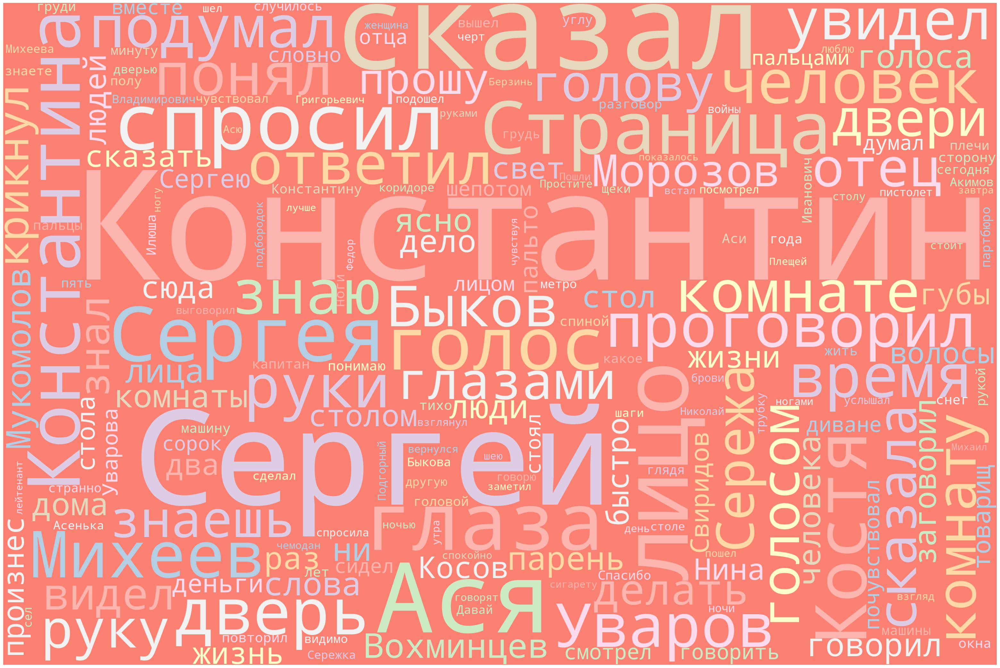

In [21]:
import re 
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS 
with open("Silence.txt", encoding="utf-8") as file:
    text = file.read()
# Clean text 
text = re.sub(r'==.*?==+', '', text) 
text = text.replace('\n', '') 
# Define a function to plot word cloud 
def plot_cloud(wordcloud): 
    # Set figure size 
    plt.figure(figsize=(40, 30)) 
    # Display image 
    plt.imshow(wordcloud)  
    # No axis details 
    plt.axis("off") 
# Generate word cloud 
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(filtered_text) 
plot_cloud(wordcloud)

Something

In [48]:
with open("Warm_snow.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized

['Юрий',
 'Бондарев',
 'ГОРЯЧИЙ',
 'СНЕГ',
 'Глава',
 'первая',
 'Кузнецову',
 'не',
 'спалось',
 '.',
 'Все',
 'сильнее',
 'стучало',
 ',',
 'гремело',
 'по',
 'крыше',
 'вагона',
 ',',
 'вьюжно',
 'ударяли',
 'нахлесты',
 'ветра',
 ',',
 'все',
 'плотнее',
 'забивало',
 'снегом',
 'едва',
 'угадываемое',
 'оконце',
 'над',
 'нарами',
 '.',
 'Паровоз',
 'с',
 'диким',
 ',',
 'раздирающим',
 'метель',
 'ревом',
 'гнал',
 'эшелон',
 'в',
 'ночных',
 'полях',
 ',',
 'в',
 'белой',
 ',',
 'несущейся',
 'со',
 'всех',
 'сторон',
 'мути',
 ',',
 'и',
 'в',
 'гремучей',
 'темноте',
 'вагона',
 ',',
 'сквозь',
 'мерзлый',
 'визг',
 'колес',
 ',',
 'сквозь',
 'тревожные',
 'всхлипы',
 ',',
 'бормотание',
 'во',
 'сне',
 'солдат',
 'был',
 'слышен',
 'этот',
 'непрерывно',
 'предупреждающий',
 'кого-то',
 'рев',
 'паровоза',
 ',',
 'и',
 'чудилось',
 'Кузнецову',
 ',',
 'что',
 'там',
 ',',
 'впереди',
 ',',
 'за',
 'метелью',
 ',',
 'уже',
 'мутно',
 'проступало',
 'зарево',
 'горящего',
 'гор

In [49]:
tagged = nltk.pos_tag(tokenized)
tagged

[('Юрий', 'JJ'),
 ('Бондарев', 'NNP'),
 ('ГОРЯЧИЙ', 'NNP'),
 ('СНЕГ', 'NNP'),
 ('Глава', 'NNP'),
 ('первая', 'NNP'),
 ('Кузнецову', 'NNP'),
 ('не', 'NNP'),
 ('спалось', 'NNP'),
 ('.', '.'),
 ('Все', 'VB'),
 ('сильнее', 'JJ'),
 ('стучало', 'NNP'),
 (',', ','),
 ('гремело', 'NNP'),
 ('по', 'NNP'),
 ('крыше', 'NNP'),
 ('вагона', 'NNP'),
 (',', ','),
 ('вьюжно', 'NNP'),
 ('ударяли', 'NNP'),
 ('нахлесты', 'NNP'),
 ('ветра', 'NNP'),
 (',', ','),
 ('все', 'NNP'),
 ('плотнее', 'NNP'),
 ('забивало', 'NNP'),
 ('снегом', 'NNP'),
 ('едва', 'NNP'),
 ('угадываемое', 'NNP'),
 ('оконце', 'NNP'),
 ('над', 'NNP'),
 ('нарами', 'NNP'),
 ('.', '.'),
 ('Паровоз', 'VB'),
 ('с', 'JJ'),
 ('диким', 'NNP'),
 (',', ','),
 ('раздирающим', 'NNP'),
 ('метель', 'NNP'),
 ('ревом', 'NNP'),
 ('гнал', 'NNP'),
 ('эшелон', 'NNP'),
 ('в', 'NNP'),
 ('ночных', 'NNP'),
 ('полях', 'NNP'),
 (',', ','),
 ('в', 'NNP'),
 ('белой', 'NNP'),
 (',', ','),
 ('несущейся', 'NNP'),
 ('со', 'NNP'),
 ('всех', 'NNP'),
 ('сторон', 'NNP'),
 ('м

In [50]:
stemmer = SnowballStemmer(language='russian')
with open("Warm_snow.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
stemmed = [stemmer.stem(word) for word in tokenized]
stemmed

['юр',
 'бондар',
 'горяч',
 'снег',
 'глав',
 'перв',
 'кузнецов',
 'не',
 'спал',
 '.',
 'все',
 'сильн',
 'стуча',
 ',',
 'гремел',
 'по',
 'крыш',
 'вагон',
 ',',
 'вьюжн',
 'ударя',
 'нахлест',
 'ветр',
 ',',
 'все',
 'плотн',
 'забива',
 'снег',
 'едв',
 'угадыва',
 'оконц',
 'над',
 'нар',
 '.',
 'паровоз',
 'с',
 'дик',
 ',',
 'раздира',
 'метел',
 'рев',
 'гнал',
 'эшелон',
 'в',
 'ночн',
 'пол',
 ',',
 'в',
 'бел',
 ',',
 'несущ',
 'со',
 'всех',
 'сторон',
 'мут',
 ',',
 'и',
 'в',
 'гремуч',
 'темнот',
 'вагон',
 ',',
 'сквоз',
 'мерзл',
 'визг',
 'колес',
 ',',
 'сквоз',
 'тревожн',
 'всхлип',
 ',',
 'бормотан',
 'во',
 'сне',
 'солдат',
 'был',
 'слыш',
 'этот',
 'непрерывн',
 'предупрежда',
 'кого-т',
 'рев',
 'паровоз',
 ',',
 'и',
 'чуд',
 'кузнецов',
 ',',
 'что',
 'там',
 ',',
 'вперед',
 ',',
 'за',
 'метел',
 ',',
 'уж',
 'мутн',
 'проступа',
 'зарев',
 'горя',
 'город',
 '.',
 'посл',
 'стоянк',
 'в',
 'саратов',
 'всем',
 'стал',
 'ясн',
 ',',
 'что',
 'дивиз',
 

In [51]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
with open("Warm_snow.txt", encoding="utf-8") as file:
    text = file.read()
tokenized = nltk.word_tokenize(text)
tokenized
morph.parse(text)

[Parse(word='                                юрий бондарев\n                                горячий снег\n                                    глава первая\n     кузнецову не спалось. все сильнее стучало, гремело по крыше вагона, вьюжно ударяли\nнахлесты ветра, все плотнее забивало снегом едва угадываемое оконце над нарами.\n     паровоз с диким, раздирающим метель ревом гнал эшелон в ночных полях, в белой,\nнесущейся со всех сторон мути, и в гремучей темноте вагона, сквозь мерзлый визг колес,\nсквозь тревожные всхлипы, бормотание во сне солдат был слышен этот непрерывно\nпредупреждающий кого-то рев паровоза, и чудилось кузнецову, что там, впереди, за метелью,\nуже мутно проступало зарево горящего города.\n     после стоянки в саратове всем стало ясно, что дивизию срочно перебрасывают под\nсталинград, а не на западный фронт, как предполагалось вначале; и теперь кузнецов знал,\nчто ехать оставалось несколько часов. и, натягивая на щеку жесткий, неприятно влажный\nворотник шинели, он ника

In [52]:
with open("Warm_snow.txt", encoding="utf-8") as file:
    text = file.read()
tokenizer = Tokenizer()
tokens = tokenizer.tokenizer(text)
print(tokens)
m=Mystem()
m.analyze('Кузнецову не спалось. Все сильнее стучало, гремело по крыше вагона, вьюжно ударяли нахлесты ветра, все плотнее забивало снегом едва угадываемое оконце над нарами. Паровоз с диким, раздирающим метель ревом гнал эшелон в ночных полях, в белой, несущейся со всех сторон мути, и в гремучей темноте вагона, сквозь мерзлый визг колес, сквозь тревожные всхлипы, бормотание во сне солдат был слышен этот непрерывный предупреждающий кого-то рев паровоза, и чудилось Кузнецову, что там, впереди, за метелью, уже мутно проступало зарево горящего города. После стоянки в Саратове всем стало ясно, что дивизию срочно перебрасывают под Сталинград, а не на Западный фронт, как предполагалось вначале; и теперь Кузнецов знал, что ехать оставалось несколько часов. И, натягивая на щеку жесткий, неприятно влажный воротник шинели, он никак не мог согреться, набрать тепло, чтобы уснуть: пронзительно дуло в невидимые щели заметенного оконца, ледяные сквозняки гуляли по нарам. «Значит, я долго не увижу мать, — съеживаясь от холода, подумал Кузнецов, — нас провезли мимо…». То, что было прошлой жизнью, — летние месяцы в училище в жарком, пыльном Актюбинске, с раскаленными ветрами из степи, с задыхающимися в закатной тишине криками ишаков на окраинах, такими ежевечерне точными по времени, что командиры взводов на тактических занятиях, изнывая от жажды, не без облегчения сверяли по ним часы, марши в одуряющем зное, пропотевшие и выжженные на солнце добела гимнастерки, скрип песка на зубах; воскресное патрулирование города, в городском саду, где по вечерам мирно играл на танцплощадке военный духовой оркестр; затем выпуск в училище, погрузка по тревоге осенней ночью в вагоны, угрюмый, в диких снегах лес, сугробы, землянки формировочного лагеря под Тамбовом, потом опять по тревоге на морозно розовеющем декабрьском рассвете спешная погрузка в эшелон и, наконец, отъезд — вся эта зыбкая, временная, кем-то управляемая жизнь потускнела сейчас, оставалась далеко позади, в прошлом. И не было надежды увидеть мать, а он совсем недавно почти не сомневался, что их повезут на запад через Москву. «Я напишу ей, — с внезапно обострившимся чувством одиночества подумал Кузнецов, — и все объясню. Ведь мы не виделись девять месяцев…». А весь вагон спал под скрежет, визг, под чугунный гул разбежавшихся колес, стены туго качались, верхние нары мотало бешеной скоростью эшелона, и Кузнецов, вздрагивая, окончательно прозябнув на сквозняках возле оконца, отогнул воротник, с завистью посмотрел на спящего рядом командира второго взвода лейтенанта Давлатяна — в темноте нар лица его не было видно. «Нет, здесь, возле окна, я не усну, замерзну до передовой», — с досадой на себя подумал Кузнецов и задвигался, пошевелился, слыша, как хрустит иней на досках вагона. Он высвободился из холодной, колючей тесноты своего места, спрыгнул с нар, чувствуя, что надо обогреться у печки: спина вконец окоченела. В железной печке сбоку закрытой двери, мерцающей толстым инеем, давно погас огонь, только неподвижным зрачком краснело поддувало. Но здесь, внизу, казалось, было немного теплее. В вагонном сумраке этот багровый отсвет угля слабо озарял разнообразно торчащие в проходе новые валенки, котелки, вещмешки под головами. Дневальный Чибисов неудобно спал на нижних нарах, прямо на ногах солдат; голова его до верха шапки была упрятана в воротник, руки засунуты в рукава. — Чибисов! — позвал Кузнецов и открыл дверцу печки, повеявшей изнутри еле уловимым теплом. — Все погасло, Чибисов! Ответа не было. — Дневальный, слышите? Чибисов испуганно вскинулся, заспанный, помятый, шапка-ушанка низко надвинута, стянута тесемками у подбородка. Еще не очнувшись ото сна, он пытался оттолкнуть ушанку со лба, развязать тесемки, непонимающе и робко вскрикивая: — Что это я? Никак, заснул? Ровно оглушило меня беспамятством. Извиняюсь я, товарищ лейтенант! Ух, до косточек пробрало меня в дремоте-то!.. — Заснули и весь вагон выстудили, — сказал с упреком Кузнецов. — Да не хотел я, товарищ лейтенант, невзначай, без умыслу, — забормотал Чибисов. — Повалило меня… Затем, не дожидаясь приказаний Кузнецова, с излишней бодростью засуетился, схватил с пола доску, разломал ее о колено и стал заталкивать обломки в печку. При этом бестолково, будто бока чесались, двигал локтями и плечами, часто нагибаясь, деловито заглядывал в поддувало, где ленивыми отблесками заползал огонь; ожившее, запачканное сажей лицо Чибисова выражало заговорщицкую подобострастность. — Я теперича, товарищ лейтенант, тепло нагоню! Накалим, ровно в баньке будет. Иззябся я сам за войну-то! Ох как иззябся, кажную косточку ломит — слов нет!.. Кузнецов сел против раскрытой дверцы печки. Ему неприятна была преувеличенно нарочитая суетливость дневального, этот явный намек на свое прошлое. Чибисов был из его взвода. И то, что он, со своим неумеренным старанием, всегда безотказный, прожил несколько месяцев в немецком плену, а с первого дня появления во взводе постоянно готов был услужить каждому, вызывало к нему настороженную жалость. Чибисов мягко, по-бабьи опустился на нары, непроспанные глаза его моргали. — В Сталинград, значит, едем, товарищ лейтенант? По сводкам-то какая мясорубка там! Не боязно вам, товарищ лейтенант? Ничего? — Приедем — увидим, что за мясорубка, — вяло отозвался Кузнецов, всматриваясь в огонь. — А вы что, боитесь? Почему спросили? — Да, можно сказать, того страху нету, что раньше-то, — фальшиво весело ответил Чибисов и, вздохнув, положил маленькие руки на колени, заговорил доверительным тоном, как бы желая убедить Кузнецова: — После, как наши из плена-то меня освободили, поверили мне, товарищ лейтенант. А я цельных три месяца, ровно щенок в дерьме, у немцев просидел. Поверили… Война вон какая огромная, разный народ воюет. Как же сразу верить-то? — Чибисов скосился осторожно на Кузнецова; тот молчал, делая вид, что занят печкой, обогреваясь ее живым теплом: сосредоточенно сжимал и разжимал пальцы над открытой дверцей. — Знаете, как в плен-то я попал, товарищ лейтенант?.. Не говорил я вам, а сказать хочу. В овраг нас немцы загнали. Под Вязьмой. И когда танки ихние вплотную подошли, окружили, а у нас и снарядов уж нет, комиссар полка на верх своей «эмки» выскочил с пистолетом, кричит: «Лучше смерть, чем в плен к фашистским гадам!» — и выстрелил себе в висок. От головы брызнуло даже. А немцы со всех сторон бегут к нам. Танки их живьем людей душат. Тут и… полковник и еще кто-то… — А потом что? — спросил Кузнецов. — Я в себя выстрелить не мог. Сгрудили нас в кучу, орут «хенде хох». И повели… — Понятно, — сказал Кузнецов с той серьезной интонацией, которая ясно говорила, что на месте Чибисова он поступил бы совершенно иначе. — Так что, Чибисов, они закричали «хенде хох» — и вы сдали оружие? Оружие-то было у вас? Чибисов ответил, робко защищаясь натянутой полуулыбкой: — Молодой вы очень, товарищ лейтенант, детей, семьи у вас нет, можно сказать. Родители небось… — При чем здесь дети? — проговорил со смущением Кузнецов, заметив на лице Чибисова тихое, виноватое выражение, и прибавил: — Это не имеет никакого значения. — Как же не имеет, товарищ лейтенант? — Ну, я, может быть, не так выразился… Конечно, у меня нет детей.')

['Юрий', 'Бондарев', 'ГОРЯЧИЙ', 'СНЕГ', 'Глава', 'первая', 'Кузнецову', 'не', 'спалось', 'Все', 'сильнее', 'стучало', 'гремело', 'по', 'крыше', 'вагона', 'вьюжно', 'ударяли', 'нахлесты', 'ветра', 'все', 'плотнее', 'забивало', 'снегом', 'едва', 'угадываемое', 'оконце', 'над', 'нарами', 'Паровоз', 'с', 'диким', 'раздирающим', 'метель', 'ревом', 'гнал', 'эшелон', 'в', 'ночных', 'полях', 'в', 'белой', 'несущейся', 'со', 'всех', 'сторон', 'мути', 'и', 'в', 'гремучей', 'темноте', 'вагона', 'сквозь', 'мерзлый', 'визг', 'колес', 'сквозь', 'тревожные', 'всхлипы', 'бормотание', 'во', 'сне', 'солдат', 'был', 'слышен', 'этот', 'непрерывно', 'предупреждающий', 'когото', 'рев', 'паровоза', 'и', 'чудилось', 'Кузнецову', 'что', 'там', 'впереди', 'за', 'метелью', 'уже', 'мутно', 'проступало', 'зарево', 'горящего', 'города', 'После', 'стоянки', 'в', 'Саратове', 'всем', 'стало', 'ясно', 'что', 'дивизию', 'срочно', 'перебрасывают', 'под', 'Сталинград', 'а', 'не', 'на', 'Западный', 'фронт', 'как', 'предпол

[{'analysis': [{'lex': 'узнецов',
    'wt': 0.8211388081,
    'qual': 'bastard',
    'gr': 'S,фам,муж,од=дат,ед'}],
  'text': 'узнецову'},
 {'text': ' '},
 {'analysis': [{'lex': 'не', 'wt': 1, 'gr': 'PART='}], 'text': 'не'},
 {'text': ' '},
 {'analysis': [{'lex': 'спаться',
    'wt': 0.9789413773,
    'gr': 'V,несов,нп=прош,изъяв,сред'}],
  'text': 'спалось'},
 {'text': '. '},
 {'analysis': [{'lex': 'все', 'wt': 0.1955883233, 'gr': 'SPRO,мн=(вин|им)'}],
  'text': 'Все'},
 {'text': ' '},
 {'analysis': [{'lex': 'сильно', 'wt': 0.2482302745, 'gr': 'ADV=срав'}],
  'text': 'сильнее'},
 {'text': ' '},
 {'analysis': [{'lex': 'стучать',
    'wt': 1,
    'gr': 'V,несов,нп=прош,ед,изъяв,сред'}],
  'text': 'стучало'},
 {'text': ', '},
 {'analysis': [{'lex': 'греметь',
    'wt': 1,
    'gr': 'V,несов,нп=прош,ед,изъяв,сред'}],
  'text': 'гремело'},
 {'text': ' '},
 {'analysis': [{'lex': 'по', 'wt': 1, 'gr': 'PR='}], 'text': 'по'},
 {'text': ' '},
 {'analysis': [{'lex': 'крыша', 'wt': 1, 'gr': 'S,же

In [22]:
import spacy

def remove_stopwords(text):
    nlp = spacy.load('ru_core_news_sm')
    doc = nlp(text)
    words = [token.text for token in doc if not token.is_stop and token.pos_ not in {'ADP', 'PRON', 'PART'}]
    filtered_text = ' '.join(words)

    return filtered_text


with open("Warm_snow.txt", encoding="utf-8") as file:
    text = file.read()
filtered_text = remove_stopwords(text)
print(filtered_text)

                                 Юрий Бондарев 
                                 ГОРЯЧИЙ СНЕГ 
                                     Глава первая 
      Кузнецову спалось . сильнее стучало , гремело крыше вагона , вьюжно ударяли 
 нахлесты ветра , плотнее забивало снегом угадываемое оконце нарами . 
      Паровоз диким , раздирающим метель ревом гнал эшелон ночных полях , белой , 
 несущейся сторон мути , гремучей темноте вагона , мерзлый визг колес , 
 тревожные всхлипы , бормотание сне солдат слышен 
 предупреждающий рев паровоза , чудилось Кузнецову , , впереди , метелью , 
 мутно проступало зарево горящего города . 
      стоянки Саратове ясно , дивизию срочно перебрасывают 
 Сталинград , Западный фронт , предполагалось ; Кузнецов знал , 
 ехать оставалось часов . , натягивая щеку жесткий , неприятно влажный 
 воротник шинели , согреться , набрать тепло , уснуть : пронзительно 
 дуло невидимые щели заметенного оконца , ледяные сквозняки гуляли нарам . 
      « , увижу мать , — съежи

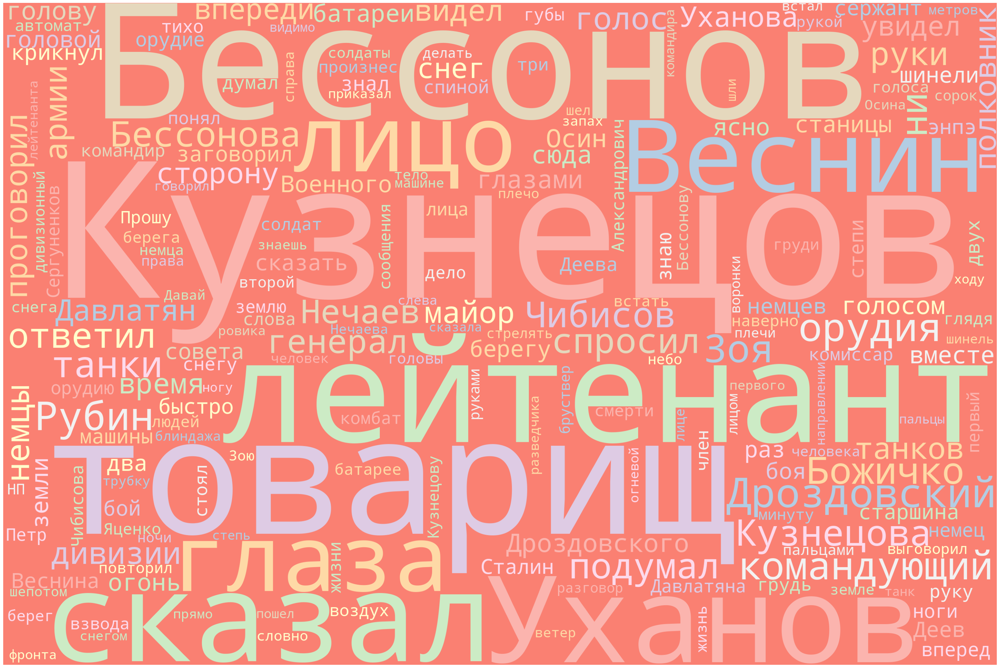

In [23]:
import re 
import matplotlib.pyplot as plt 
from wordcloud import WordCloud, STOPWORDS 
with open("Warm_snow.txt", encoding="utf-8") as file:
    text = file.read()
# Clean text 
text = re.sub(r'==.*?==+', '', text) 
text = text.replace('\n', '') 
# Define a function to plot word cloud 
def plot_cloud(wordcloud): 
    # Set figure size 
    plt.figure(figsize=(40, 30)) 
    # Display image 
    plt.imshow(wordcloud)  
    # No axis details 
    plt.axis("off") 
# Generate word cloud 
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(filtered_text) 
plot_cloud(wordcloud)

Something

Finally